In [6]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
import itertools
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import colour
from colour.models import Lab_to_XYZ, XYZ_to_RGB, XYZ_to_xy


### Load in Prototype CSVs

In [7]:
prototypes = pd.read_csv('https://raw.githubusercontent.com/Knowledge-and-Concepts-Lab/color-semantics-neural/refs/heads/main/data/prototypes.csv')

In [8]:
### Do color conversions

prototypes['X'] = prototypes.apply(lambda x: colour.xyY_to_XYZ(x[['x','y','Y']])[0], axis=1)

prototypes['Y_'] = prototypes.apply(lambda x: colour.xyY_to_XYZ(x[['x','y','Y']])[1], axis=1)

prototypes['Z'] = prototypes.apply(lambda x: colour.xyY_to_XYZ(x[['x','y','Y']])[2], axis=1)

prototypes['L'] = prototypes.apply(lambda x: colour.XYZ_to_Lab(x[['X','Y','Z']])[0], axis=1)

prototypes['a'] = prototypes.apply(lambda x: colour.XYZ_to_Lab(x[['X','Y','Z']])[1], axis=1)

prototypes['b'] = prototypes.apply(lambda x: colour.XYZ_to_Lab(x[['X','Y','Z']])[2], axis=1)

proto_rgb = colour.XYZ_to_RGB(prototypes[['X','Y','Z']],
                              "sRGB",
                    colour.RGB_COLOURSPACES['sRGB'].whitepoint,
                    # colour.RGB_COLOURSPACES['sRGB'].matrix_XYZ_to_RGB,
                    apply_cctf_encoding=False)


In [9]:
prototypes

,color,x,y,Y,X,Y_,Z,L,a,b
0,red,0.5734,0.3057,0.12000,0.225083,0.12000,0.047458,41.216120,62.721946,28.268299
1,orange,0.5698,0.3990,0.30050,0.429135,0.30050,0.023498,61.697339,48.678908,78.282316
2,yellow,0.4791,0.5012,0.59100,0.564940,0.59100,0.023230,81.346532,0.800460,112.372798
3,green,0.2940,0.5751,0.19770,0.101067,0.19770,0.044999,51.576166,-54.395944,47.367770
4,blue,0.1805,0.1888,0.12000,0.114725,0.12000,0.400869,41.216120,0.481876,-44.684802
5,purple,0.2772,0.1707,0.06555,0.106447,0.06555,0.212010,30.771599,39.409248,-35.272272
6,pink,0.3743,0.3248,0.59100,0.681069,0.59100,0.547512,81.346532,27.830826,8.809391
7,brown,0.4966,0.3908,0.06555,0.083296,0.06555,0.018887,30.771599,20.490984,28.872234


In [10]:
### visualize the prototypes

fig1 = make_subplots(rows=1, cols=1,
                        specs=[[{'type': 'scatter3d'}]],  # Enclose in another list
                        subplot_titles=([f'CIELAB space coordinates for prototypes']))

# Plot LAB points
fig1.add_trace(
    go.Scatter3d(
        x=prototypes.loc[:, 'a'],
        y=prototypes.loc[:, 'b'],
        z=prototypes.loc[:, 'L'], 
        mode='markers',
        marker=dict(
            size=10,
            color=proto_rgb,
            # colorscale='identity',  # Use actual RGB values as colors
            opacity=0.8,
            line=dict(color='rgb(0, 0, 0)', width=0.5)
        ),
        name='LAB colors'
    ),
    row=1, col=1
)
fig1.update_layout(
    # paper_bgcolor='rgb(89, 89, 89)',
    scene=dict(
        xaxis_title='a',
        yaxis_title='b',
        zaxis_title='L',
        aspectmode='manual',
        aspectratio=dict(x=1, y=1, z=1),
        xaxis=dict(range=[-100, 150], gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),  # Add gridcolor here
        yaxis=dict(range=[-100, 150], gridcolor='gray',backgroundcolor = 'rgb(89, 89, 89)'),  # Add gridcolor here
        zaxis=dict(range=[0, 100], gridcolor='gray',backgroundcolor = 'rgb(89, 89, 89)'),
    )
)


In [11]:

def sample_LAB(delta, rot):
    """
    Generates a grid of points uniformly spaced in CIELAB space which can be mapped to RGB space.

    Parameters:
    -----------
    delta : float
        Spacing between points in the LAB space
    rot : float
        Rotation angle in degrees

    Returns:
    --------
    lab : ndarray
        Coordinates in LAB space
    rgb : ndarray
        Coordinates in RGB space
    xyY : ndarray
        Coordinates in xyY space
    """
    # Generate delta spaced points for L (0-100), a(-100 to 100) and b (-100 to 100)
    L = np.arange(0, 100+delta, delta)
    ### add an additional lightness plane at L = 88
    L = np.concatenate([L, np.arange(88, 100+delta, delta)])
    a = np.concatenate([np.arange(0-delta, -100*np.sqrt(2), -delta),
                       np.arange(0, 100*np.sqrt(2)+delta, delta)])
    b = a.copy()

    # Create all combinations (equivalent to MATLAB's combvec)
    lab = np.array(list(itertools.product(L, a, b)))
    lab_orig = lab.copy()

    white_point_idx = None
    for idx, point in enumerate(lab):
        if np.isclose(point[0], 100) and np.isclose(point[1], 0) and np.isclose(point[2], 0):
            white_point_idx = idx
            print(f"White point found at index {idx} before rotation: {point}")
            break

    if white_point_idx is None:
        print("Warning: White point (L=100, a=0, b=0) not found in original data")


    # Apply rotation
    rot_rad = np.radians(rot)
    rotation_matrix = np.array([
        [1, 0, 0],
        [0, np.cos(rot_rad), np.sin(rot_rad)],
        [0, -np.sin(rot_rad), np.cos(rot_rad)]
    ])
    lab = np.dot(lab, rotation_matrix)

    # if white_point_idx is not None:
    #     print(f"White point after rotation: {lab[white_point_idx]}")
    # print(f'current lab shape', lab.shape)

    # Convert LAB to RGB
    # First convert LAB to XYZ (using colour science package)
    xyz = Lab_to_XYZ(lab, illuminant=colour.CCS_ILLUMINANTS['CIE 1931 2 Degree Standard Observer']['D65'])


    # Then convert XYZ to RGB
    rgb = XYZ_to_RGB(xyz,
                    colour.RGB_COLOURSPACES['sRGB'].whitepoint,
                    colour.RGB_COLOURSPACES['sRGB'].whitepoint,
                    colour.RGB_COLOURSPACES['sRGB'].matrix_XYZ_to_RGB,
                    apply_cctf_encoding=False)

    # Find valid RGB colors (between 0 and 1)
    valid_mask = ~np.any((rgb > 1+np.finfo(float).eps) | (rgb < 0-np.finfo(float).eps), axis=1)
    # print(f'rgb whitepoint?', rgb[642])
    # Get rid of coordinates which do not exist in RGB space
    rgb = rgb[valid_mask]

    lab = lab[valid_mask]
    lab_orig = lab_orig[valid_mask]

    # Convert LAB to xyY
    xy = XYZ_to_xy(xyz[valid_mask])
    Y = xyz[valid_mask, 1]  # Y component from XYZ
    xyY = np.column_stack([xy, Y])


    white_exists = False
    for idx, point in enumerate(lab):
        if np.isclose(point[0], 100) and np.abs(point[1]) < 1e-10 and np.abs(point[2]) < 1e-10:
            white_exists = True
            print(f"White point exists in dataset at index {idx}: {point}")
            print(f"Corresponding RGB: {rgb[idx]}")
            break

    # If white point doesn't exist, manually add it
    if not white_exists:
        print("White point not found in dataset. Adding manually...")

        # Create white point in LAB space
        white_lab = np.array([[100, 0, 0]])

        # Convert to XYZ and then RGB
        white_xyz = Lab_to_XYZ(white_lab, illuminant=colour.CCS_ILLUMINANTS['CIE 1931 2 Degree Standard Observer']['D65'])
        white_rgb = XYZ_to_RGB(white_xyz,
                            colour.RGB_COLOURSPACES['sRGB'].whitepoint,
                            colour.RGB_COLOURSPACES['sRGB'].whitepoint,
                            colour.RGB_COLOURSPACES['sRGB'].matrix_XYZ_to_RGB,
                            apply_cctf_encoding=False)

        ###if any value in white_rgb is >1.0 then set it to 1
        white_rgb = np.clip(white_rgb, 0, 1)

        # Convert to xyY
        white_xy = XYZ_to_xy(white_xyz)
        white_Y = white_xyz[:, 1]  # Y component from XYZ
        white_xyY = np.column_stack([white_xy, white_Y])

        # Append to existing arrays
        lab = np.vstack([lab, white_lab])
        rgb = np.vstack([rgb, white_rgb])

        # Create a placeholder for lab_orig (not critical)
        white_lab_orig = white_lab.copy()
        lab_orig = np.vstack([lab_orig, white_lab_orig])

        # Append to xyY
        xyY = np.vstack([xyY, white_xyY])

        print(f"Added white point: LAB={white_lab[0]}, RGB={white_rgb[0]}")
    else:
        print("White point already exists in dataset.")

    # Convert LAB to xyY if not already done
    if 'xyY' not in locals():
        xy = XYZ_to_xy(xyz[valid_mask])
        Y = xyz[valid_mask, 1]  # Y component from XYZ
        xyY = np.column_stack([xy, Y])

    # Create figures
    fig1 = make_subplots(rows=1, cols=2,
                        specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}]],
                        subplot_titles=([f'LAB space with uniformly distributed points for δ = {delta}',
                                        f'Selected colors in xyY space for δ = {delta}']))

    # Plot LAB points
    fig1.add_trace(
        go.Scatter3d(
            x=lab[:, 1],
            y=lab[:, 2],
            z=lab[:, 0],
            mode='markers',
            marker=dict(
                size=5,
                color=rgb,
                # colorscale='identity',  # Use actual RGB values as colors
                opacity=0.8,
                line=dict(color='rgb(0, 0, 0)', width=0.5)
            ),
            name='LAB colors'
        ),
        row=1, col=1
    )

    # Plot xyY points
    fig1.add_trace(
        go.Scatter3d(
            x=xyY[:, 0],
            y=xyY[:, 1],
            z=xyY[:, 2],
            mode='markers',
            marker=dict(
                size=7,
                color=rgb,
                # colorscale='identity',  # Use actual RGB values as colors
                opacity=0.8,
                line=dict(color='rgb(0, 0, 0)', width=0.5)
            ),
            name='xyY colors'
        ),
        row=1, col=2
    )

    # Update layout
    fig1.update_layout(
        scene=dict(
            xaxis_title='a',
            yaxis_title='b',
            zaxis_title='L',
            aspectmode='manual',
            aspectratio=dict(x=1, y=1, z=1),
            xaxis=dict(range=[-100, 100],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            yaxis=dict(range=[-100, 100],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            zaxis=dict(range=[0, 100],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)')
        ),
        scene2=dict(
            xaxis_title='x',
            yaxis_title='y',
            zaxis_title='Y',
            aspectmode='manual',
            aspectratio=dict(x=1, y=1, z=1),
            xaxis=dict(range=[0, 1],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            yaxis=dict(range=[0, 1],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            zaxis=dict(range=[0, 1],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)')
        ),
        height=800,
        width=1800
    )

    # Create figure 2 with 2D projections
    fig2 = make_subplots(rows=1, cols=3,
                        subplot_titles=('a* vs b*', 'b* vs L*', 'a* vs L*'))

    # a* vs b*
    fig2.add_trace(
        go.Scatter(
            x=lab[:, 1],
            y=lab[:, 2],
            mode='markers',
            marker=dict(
                size=8,
                color=[f'rgb({r*255},{g*255},{b*255})' for r, g, b in rgb],
                opacity=0.8
            ),
            name='a* vs b*'
        ),
        row=1, col=1
    )

    # b* vs L*
    fig2.add_trace(
        go.Scatter(
            x=lab[:, 2],
            y=lab[:, 0],
            mode='markers',
            marker=dict(
                size=8,
                color=[f'rgb({r*255},{g*255},{b*255})' for r, g, b in rgb],
                opacity=0.8
            ),
            name='b* vs L*'
        ),
        row=1, col=2
    )

    # a* vs L*
    fig2.add_trace(
        go.Scatter(
            x=lab[:, 1],
            y=lab[:, 0],
            mode='markers',
            marker=dict(
                size=8,
                color=[f'rgb({r*255},{g*255},{b*255})' for r, g, b in rgb],
                opacity=0.8
            ),
            name='a* vs L*'
        ),
        row=1, col=3
    )

    # Update layout for fig2
    fig2.update_layout(
        height=600,
        width=1800,
        showlegend=False,
        plot_bgcolor='rgb(77, 77, 77)'  # Dark gray background
    )

    # Update x and y ranges for all subplots
    for i in range(1, 4):
        fig2.update_xaxes(range=[-110, 110], row=1, col=i)

    # Update y ranges
    fig2.update_yaxes(range=[-110, 110], row=1, col=1)  # a* vs b*
    fig2.update_yaxes(range=[-10, 110], row=1, col=2)   # b* vs L*
    fig2.update_yaxes(range=[-10, 110], row=1, col=3)   # a* vs L*

    # Update aspect ratios
    for i in range(1, 4):
        fig2.update_xaxes(scaleanchor=f"y{i}", scaleratio=1, row=1, col=i)

    # Display number of colors
    print(f"Number of colors: {len(rgb)}")

    # Add text annotation (equivalent to the text display in MATLAB)
    fig1.add_annotation(
        text=f"# Colors: {len(rgb)}",
        xref="paper", yref="paper",
        x=0.02, y=0.98,
        showarrow=False
    )

    # Display figures
    fig1.show()
    fig2.show()

    # Option to save data
    # pd.DataFrame(lab, columns=['L', 'a', 'b']).to_csv('Lab.csv', index=False)
    # pd.DataFrame(rgb, columns=['R', 'G', 'B']).to_csv('RGB.csv', index=False)
    # pd.DataFrame(xyY, columns=['x', 'y', 'Y']).to_csv('xyY.csv', index=False)
    # pd.DataFrame(lab_orig, columns=['L', 'a', 'b']).to_csv('LabOrig.csv', index=False)

    return lab, rgb, xyY

In [12]:
def subsample_colors(lab, 
                     rgb, 
                     xyY, 
                     method="random", 
                     n_colors=50, 
                     seed=42, 
                     prototypes=None):
    """
    Subsample from an existing set of colors.

    Parameters:
    -----------
    lab : ndarray
        LAB coordinates of the colors
    rgb : ndarray
        RGB values of the colors
    xyY : ndarray
        xyY coordinates of the colors
    method : str
        Subsampling method: "random", "kmeans", "grid", "perceptual", or "preserve_white"
    n_colors : int
        Number of colors to select
    seed : int
        Random seed for reproducibility
    prototypes : DataFrame
        DataFrame containing prototype colors with 'L', 'a', 'b' columns

    Returns:
    --------
    lab_sub : ndarray
        Subsampled LAB coordinates
    rgb_sub : ndarray
        Subsampled RGB values
    xyY_sub : ndarray
        Subsampled xyY coordinates
    """
    np.random.seed(seed)
    total_colors = len(lab)

    if n_colors >= total_colors:
        print(f"Requested {n_colors} colors but only {total_colors} available. Returning all colors.")
        return lab, rgb, xyY

    # Make sure indices will be unique (avoid duplicates)
    if method != "kmeans" and method != "perceptual":
        n_colors = min(n_colors, total_colors)

    # Implement different subsampling methods
    if method == "random":
        # Simple random sampling
        indices = np.random.choice(total_colors, n_colors, replace=False)

    elif method == "grid":
        # Try to maintain a grid-like structure by selecting evenly spaced indices
        indices = np.round(np.linspace(0, total_colors - 1, n_colors)).astype(int)

    elif method == "kmeans":
        # Use K-means clustering to find representative colors
        from sklearn.cluster import KMeans
        kmeans = KMeans(n_clusters=n_colors, random_state=seed)
        kmeans.fit(lab)

        # Get the closest point to each cluster center
        centers = kmeans.cluster_centers_
        indices = []
        for center in centers:
            # Find the closest point to this center
            distances = np.linalg.norm(lab - center, axis=1)
            closest_idx = np.argmin(distances)
            indices.append(closest_idx)

    elif method == "perceptual":
        # Use a perceptual distance measure (ΔE) to select colors that are perceptually distinct
        from sklearn.metrics.pairwise import euclidean_distances

        selected = []

        # 1. Start with white if it exists
        white_idx = None
        for idx, point in enumerate(lab):
            if np.isclose(point[0], 100) and np.abs(point[1]) < 1e-10 and np.abs(point[2]) < 1e-10:
                white_idx = idx
                break

        if white_idx is not None:
            selected.append(white_idx)
            print(f"Added white: LAB={lab[white_idx]}")

        # 2. Add black if it exists
        if len(selected) < n_colors:
            black_idx = None
            for idx, point in enumerate(lab):
                if np.isclose(point[0], 0) and np.abs(point[1]) < 1e-10 and np.abs(point[2]) < 1e-10:
                    black_idx = idx
                    break

            if black_idx is not None and black_idx not in selected:
                selected.append(black_idx)
                print(f"Added black: LAB={lab[black_idx]}")

        # 3. Add colors closest to prototypes
        if prototypes is not None and len(selected) < n_colors:
            print("Adding colors closest to prototypes...")

            # Ensure the prototype DataFrame has L, a, b columns
            if not all(col in prototypes.columns for col in ['L', 'a', 'b']):
                # If we have xyY coordinates in the prototypes, convert them to LAB
                if all(col in prototypes.columns for col in ['x', 'y', 'Y']):
                    print("Converting prototype xyY coordinates to LAB...")

                    # Create XYZ from xyY
                    prototype_XYZ = []
                    for _, row in prototypes.iterrows():
                        x, y, Y = row['x'], row['y'], row['Y']
                        if y == 0:  # Avoid division by zero
                            X, Z = 0, 0
                        else:
                            X = (x * Y) / y
                            Z = ((1 - x - y) * Y) / y
                        prototype_XYZ.append([X, Y, Z])

                    prototype_XYZ = np.array(prototype_XYZ)

                    # Convert XYZ to LAB
                    prototype_lab = colour.XYZ_to_Lab(
                        prototype_XYZ,
                        illuminant=colour.CCS_ILLUMINANTS['CIE 1931 2 Degree Standard Observer']['D65']
                    )

                    # Create L, a, b columns in the prototypes DataFrame
                    prototypes = prototypes.copy()
                    prototypes['L'] = prototype_lab[:, 0]
                    prototypes['a'] = prototype_lab[:, 1]
                    prototypes['b'] = prototype_lab[:, 2]
                else:
                    raise ValueError("Prototype DataFrame must have either 'L', 'a', 'b' columns or 'x', 'y', 'Y' columns")

            # For each prototype, find the closest point in our dataset
            for _, prototype in prototypes.iterrows():
                if len(selected) < n_colors:
                    prototype_lab = np.array([prototype['L'], prototype['a'], prototype['b']])
                    distances = np.linalg.norm(lab - prototype_lab, axis=1)

                    # Find closest point not already selected
                    sorted_indices = np.argsort(distances)
                    for idx in sorted_indices:
                        if idx not in selected:
                            selected.append(idx)
                            print(f"Added color closest to {prototype.get('color', 'unnamed prototype')}: LAB={lab[idx]}")
                            break
        good_yellow_lab = [88.00000,3.92519, 74.89722]
        good_yellow_idx  = None
        for idx, point in enumerate(lab):
            if np.isclose(point[0], good_yellow_lab[0],atol=0, rtol=1e-04) and np.isclose(point[1], good_yellow_lab[1],atol=0, rtol=1e-04) and np.isclose(point[2], good_yellow_lab[2],atol=0, rtol=1e-04):
                good_yellow_idx = idx
                break

        if good_yellow_idx is not None and good_yellow_idx not in selected:
            selected.append(good_yellow_idx)
            print(f"Added good yellow: LAB={lab[good_yellow_idx]}")
        else:
            print("No good yellow found in the dataset.")



        # 4. Greedily select remaining colors that maximize minimum distance to already selected colors
        remaining = list(set(range(total_colors)) - set(selected))

        while len(selected) < n_colors and remaining:
            # For each remaining color, compute minimum distance to any selected color
            min_distances = []
            for idx in remaining:
                dists = [euclidean_distances([lab[idx]], [lab[sel]])[0][0] for sel in selected]
                min_distances.append(min(dists))

            # Choose the color with the maximum minimum distance
            best_idx = remaining[np.argmax(min_distances)]
            selected.append(best_idx)
            remaining.remove(best_idx)

        indices = selected

    elif method == "preserve_white":
        # Ensure white is included, then randomly sample the rest
        white_idx = None
        for idx, point in enumerate(lab):
            if np.isclose(point[0], 100) and np.abs(point[1]) < 1e-10 and np.abs(point[2]) < 1e-10:
                white_idx = idx
                break

        # Random sampling for the rest
        other_indices = list(range(total_colors))
        if white_idx is not None:
            other_indices.remove(white_idx)
            indices = [white_idx] + list(np.random.choice(other_indices, n_colors-1, replace=False))
        else:
            indices = list(np.random.choice(other_indices, n_colors, replace=False))

    else:
        raise ValueError(f"Unknown method: {method}. Choose from 'random', 'kmeans', 'grid', 'perceptual', or 'preserve_white'.")

    # Extract the selected colors
    lab_sub = lab[indices]
    rgb_sub = rgb[indices]
    xyY_sub = xyY[indices]

    # Display the subsampled colors
    rgb_strings = [f'rgb({r*255},{g*255},{b*255})' for r, g, b in rgb_sub]

    # Create 3D plot of subsampled colors
    fig = make_subplots(rows=1, cols=2,
                     specs=[[{'type': 'scatter3d'}, {'type': 'scatter3d'}]],
                     subplot_titles=([f'Subsampled LAB space ({method}, n={n_colors})',
                                     f'Subsampled xyY space ({method}, n={n_colors})']))

    # Plot LAB points
    fig.add_trace(
        go.Scatter3d(
            x=lab_sub[:, 1],
            y=lab_sub[:, 2],
            z=lab_sub[:, 0],
            mode='markers',
            marker=dict(
                size=8,
                color=rgb_strings,
                opacity=0.8
            ),
            name='LAB colors'
        ),
        row=1, col=1
    )

    # Plot xyY points
    fig.add_trace(
        go.Scatter3d(
            x=xyY_sub[:, 0],
            y=xyY_sub[:, 1],
            z=xyY_sub[:, 2],
            mode='markers',
            marker=dict(
                size=10,
                color=rgb_strings,
                opacity=0.8,
                line=dict(color='rgb(0, 0, 0)', width=0.5)
            ),
            name='xyY colors'
        ),
        row=1, col=2
    )

    # Update layout
    fig.update_layout(
        scene=dict(
            xaxis_title='a',
            yaxis_title='b',
            zaxis_title='L',
            aspectmode='manual',
            aspectratio=dict(x=1, y=1, z=1),
            xaxis=dict(range=[-100, 100],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            yaxis=dict(range=[-100, 100],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            zaxis=dict(range=[0, 100],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
 
        ),
        scene2=dict(
            xaxis_title='x',
            yaxis_title='y',
            zaxis_title='Y',
            aspectmode='manual',
            aspectratio=dict(x=1, y=1, z=1),
            xaxis=dict(range=[0, 1],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            yaxis=dict(range=[0, 1],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)'),
            zaxis=dict(range=[0, 1],gridcolor='gray', backgroundcolor = 'rgb(89, 89, 89)')
        ),
        height=700,
        width=1600
    )

    fig.show()

    print(f"Original set: {total_colors} colors")
    print(f"Subsampled: {len(lab_sub)} colors using {method} method")

    # Also create a 2D grid visualizing the colors
    n_cols = int(np.ceil(np.sqrt(n_colors)))
    n_rows = int(np.ceil(n_colors / n_cols))

    # plt.figure(figsize=(10, 10))
    # for i, color in enumerate(rgb_sub):
    #     plt.subplot(n_rows, n_cols, i+1)
    #     plt.axis('off')
    #     plt.gca().set_facecolor(color)

    # plt.tight_layout()
    # plt.suptitle(f"Subsampled Colors ({method})", y=0.95)
    # plt.show()

    return lab_sub, rgb_sub, xyY_sub

In [13]:
lab, rgb, xyY = sample_LAB(delta=25, rot=3)

White point found at index 641 before rotation: [ 100.    0.    0.]
White point not found in dataset. Adding manually...
Added white point: LAB=[100   0   0], RGB=[ 0.99984328  1.          1.        ]
Number of colors: 71


/mnt/ws/home/kmukherjee/miniconda3/envs/norms/lib/python3.10/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning:

The "colour.XYZ_to_RGB" definition signature has changed with "Colour 0.4.3". The used call arguments are deprecated, please refer to the documentation for more information about the new signature.



In [14]:

# # Then subsample with your preferred method:
lab_sub, rgb_sub, xyY_sub = subsample_colors(lab, rgb, xyY, method="perceptual", n_colors=35, prototypes=prototypes)

Added white: LAB=[ 100.    0.    0.]
Added black: LAB=[ 0.  0.  0.]
Adding colors closest to prototypes...
Added color closest to red: LAB=[ 50.          73.5888162   28.89093509]
Added color closest to orange: LAB=[ 50.          47.31467893  52.54827455]
Added color closest to yellow: LAB=[ 75.          -3.92519672  74.89721511]
Added color closest to green: LAB=[ 50.         -52.54827455  47.31467893]
Added color closest to blue: LAB=[ 50.           2.61679781 -49.93147674]
Added color closest to purple: LAB=[ 25.          51.23987564 -22.34894056]
Added color closest to pink: LAB=[ 75.          24.96573837   1.30839891]
Added color closest to brown: LAB=[ 25.          23.65733946  26.27413727]
No good yellow found in the dataset.


Original set: 71 colors
Subsampled: 35 colors using perceptual method


In [15]:
## make a dataframe with all the color coordinates for the subsampled colors
subsampled_colors = pd.DataFrame({
    'L': np.round(lab_sub[:, 0],3),
    'a': np.round(lab_sub[:, 1],3),
    'b': np.round(lab_sub[:, 2],3),
    'R': np.round(rgb_sub[:, 0],3),
    'G': np.round(rgb_sub[:, 1],3),
    'B': np.round(rgb_sub[:, 2],3),
    'x': np.round(xyY_sub[:, 0],3),
    'y': np.round(xyY_sub[:, 1],3),
    'Y': np.round(xyY_sub[:, 2],3)
})

subsampled_colors

,L,a,b,R,G,B,x,y,Y
0,100.0,0.000,0.000,1.000,1.000,1.000,0.313,0.329,1.000
1,0.0,0.000,0.000,0.000,0.000,0.000,0.000,0.000,0.000
2,50.0,73.589,28.891,0.807,0.011,0.070,0.566,0.299,0.184
3,50.0,47.315,52.548,0.601,0.078,0.011,0.563,0.373,0.184
4,75.0,-3.925,74.897,0.663,0.477,0.006,0.444,0.481,0.483
5,50.0,-52.548,47.315,0.004,0.255,0.010,0.297,0.577,0.184
6,50.0,2.617,-49.931,0.002,0.196,0.604,0.187,0.192,0.184
7,25.0,51.240,-22.349,0.169,0.000,0.112,0.369,0.181,0.044
8,75.0,24.966,1.308,0.792,0.392,0.474,0.357,0.312,0.483
9,25.0,23.657,26.274,0.124,0.024,0.007,0.522,0.377,0.044


In [16]:
uw71_coords_original = pd.read_csv('../../data/UW71coordinates.csv')
uw71_coords_original['L'] = np.round(uw71_coords_original['L'],3)
uw71_coords_original['a'] = np.round(uw71_coords_original['a'],3)
uw71_coords_original['b'] = np.round(uw71_coords_original['b'],3)

In [17]:
subsampled_colors['v_index'] = None
subsampled_colors['color_index'] = None

match_count = 0

for idx, row in subsampled_colors.iterrows():
    matches = uw71_coords_original[(uw71_coords_original['L'] == row['L']) & 
                                   (uw71_coords_original['a'] == row['a']) & 
                                   (uw71_coords_original['b'] == row['b'])]
    
    if len(matches) > 0:
        # Get the first match (should be unique if coordinates are unique)
        match = matches.iloc[0]
        subsampled_colors.at[idx, 'v_index'] = match['v_index']
        subsampled_colors.at[idx, 'color_index'] = match['color_index']
        match_count += 1

# Report matching results
print(f"Found exact matches for {match_count} out of {len(subsampled_colors)} colors")


Found exact matches for 35 out of 35 colors


In [18]:
subsampled_colors = subsampled_colors.sort_values(by=['b', 'a', 'L']).reset_index(drop=True)
subsampled_colors
subsampled_colors.to_csv('../../data/subsampled_colors.csv', index=False)

In [42]:
uw71_coords_original

,v_index,color_index,L,a,b,C,H,r_rgb,g_rgb,b_rgb,r255,g255,b255,color_hex
0,V1,0,50,28.891,-73.589,79.057136,291.434944,0.18536,0.431390,0.964970,47.26680,110.004450,246.067350,#2f6ef6
1,V2,1,25,53.857,-72.280,90.138642,306.690392,0.20878,0.093277,0.677550,53.23890,23.785635,172.775250,#3518ad
2,V3,2,50,53.857,-72.280,90.138642,306.690392,0.52107,0.343280,0.957410,132.87285,87.536400,244.139550,#8558f4
3,V4,3,50,78.822,-70.972,106.065699,317.999859,0.71554,0.182090,0.950150,182.46270,46.432950,242.288250,#b62ef2
4,V5,4,50,2.617,-49.931,49.999524,273.000031,0.02815,0.479950,0.800070,7.17825,122.387250,204.017850,#077acc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66,V67,66,75,-28.891,73.589,79.057136,111.434944,0.66567,0.770750,0.060920,169.74585,196.541250,15.534600,#aac510
67,V68,67,88,-28.891,73.589,79.057136,111.434944,0.81500,0.913800,0.258170,207.82500,233.019000,65.833350,#d0e942
68,V69,68,75,-3.925,74.897,74.999785,93.000011,0.83409,0.720190,0.066708,212.69295,183.648450,17.010540,#d5b811
69,V70,69,88,-3.925,74.897,74.999785,93.000011,0.98973,0.860650,0.257390,252.38115,219.465750,65.634450,#fcdb42


In [43]:
subsampled_colors

,L,a,b,R,G,B,x,y,Y,v_index,color_index
0,50.0,28.891,-73.589,0.029,0.156,0.922,0.178,0.140,0.184,V1,0
1,25.0,53.857,-72.280,0.036,0.009,0.417,0.174,0.083,0.044,V2,1
2,50.0,78.822,-70.972,0.470,0.028,0.890,0.259,0.131,0.184,V4,3
3,50.0,2.617,-49.931,0.002,0.196,0.604,0.187,0.192,0.184,V5,4
4,25.0,27.583,-48.623,0.027,0.030,0.239,0.191,0.130,0.044,V6,5
5,50.0,52.548,-47.315,0.376,0.087,0.580,0.279,0.176,0.184,V9,8
6,75.0,-23.657,-26.274,0.075,0.571,0.807,0.224,0.284,0.483,V11,10
7,25.0,1.308,-24.966,0.012,0.046,0.119,0.208,0.214,0.044,V12,11
8,75.0,1.308,-24.966,0.352,0.491,0.793,0.263,0.274,0.483,V14,13
9,50.0,26.274,-23.657,0.280,0.139,0.349,0.298,0.240,0.184,V16,15


### read in association data

In [19]:
cc_assoc_ratings = pd.read_csv('../../data/uw71_all_concept_ratings.csv', index_col=0)
### name the current index column concept, make it a column then reset index
cc_assoc_ratings['concept'] = cc_assoc_ratings.index
cc_assoc_ratings = cc_assoc_ratings.reset_index(drop=True)
cc_assoc_ratings

,0,1,2,3,4,5,6,7,8,9,...,62,63,64,65,66,67,68,69,70,concept
0,0.649375,0.461193,0.473295,0.477159,0.631136,0.500284,0.524091,0.296591,0.484205,0.470398,...,0.415682,0.589432,0.550000,0.585739,0.513864,0.586136,0.565795,0.643239,0.556534,above
1,0.225650,0.323600,0.223300,0.304400,0.185750,0.331800,0.218850,0.363900,0.219550,0.335300,...,0.825300,0.197250,0.246050,0.193250,0.256200,0.200150,0.277350,0.301250,0.461400,angry
2,0.758500,0.575778,0.232556,0.213278,0.764333,0.613500,0.364667,0.192444,0.207889,0.265444,...,0.237333,0.303222,0.320889,0.347389,0.357056,0.449611,0.595111,0.706111,0.556611,beach
3,0.426080,0.529886,0.427386,0.392727,0.494318,0.560682,0.484432,0.522216,0.385568,0.330625,...,0.486023,0.345682,0.360398,0.306477,0.396648,0.308580,0.343352,0.278352,0.408409,below
4,0.489489,0.409148,0.431875,0.429943,0.473239,0.437330,0.508920,0.474091,0.454034,0.437784,...,0.384318,0.418011,0.460682,0.432273,0.443523,0.419659,0.415568,0.467273,0.437443,beside
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,0.497250,0.464750,0.441050,0.435850,0.528500,0.477200,0.529500,0.399500,0.442350,0.425700,...,0.394800,0.388350,0.453500,0.414800,0.426300,0.425050,0.514150,0.563800,0.535750,reliability
66,0.548950,0.483150,0.453800,0.331050,0.570600,0.526150,0.507250,0.439200,0.400000,0.370150,...,0.302250,0.462350,0.535750,0.481350,0.448100,0.538900,0.520000,0.521600,0.465800,safety
67,0.595865,0.697452,0.584327,0.400337,0.567067,0.790721,0.691827,0.613702,0.479087,0.276442,...,0.152740,0.213317,0.240240,0.215192,0.253558,0.221538,0.244567,0.263702,0.243990,sleeping
68,0.516400,0.422200,0.449800,0.494750,0.453200,0.337400,0.414300,0.324400,0.412450,0.604050,...,0.718650,0.719750,0.682550,0.695450,0.533700,0.609500,0.601450,0.603550,0.596400,speed


### trial generator

In [184]:
import random
from random import Random

rng = Random(42)  # Set a seed for reproducibility
def generate_dimension_seeds(n, rng=rng, possible_values=['L', 'a', 'b']):
    """
    Generates three lists of length n, where for each index i,
    the values at list1[i], list2[i], and list3[i] are a unique
    permutation of (0, 1, 2).

    Parameters:
    -----------
    n : int
        The desired length of the lists.

    Returns:
    --------
    tuple
        A tuple containing three lists: (list1, list2, list3).
    """
    if not isinstance(n, int) or n < 0:
        raise ValueError("n must be a non-negative integer.")

    list1 = [0] * n
    list2 = [0] * n
    list3 = [0] * n


    for i in range(n):
        # Shuffle the possible values for the current position
        shuffled_values = rng.sample(possible_values, len(possible_values))
        
        list1[i] = shuffled_values[0]
        list2[i] = shuffled_values[1]
        list3[i] = shuffled_values[2]
        
    return list1, list2, list3

# Example Usage:
n_items = 5
rng = Random(42)  # Set a seed for reproducibility
set1, set2, set3 = generate_dimension_seeds(35)
rng = Random(42)  # Set a seed for reproducibility
set1_num, set2_num, set3_num = generate_dimension_seeds(35,possible_values=[0,1,2])

In [27]:

from scipy.spatial.distance import pdist, squareform

def generate_similarity_triplets(subsampled_colors_df, distance_threshold=80):
    """
    Generates triplets of (target, close, far) color indices for a similarity task.

    For each color (target), it finds another color (close) that is nearby in 
    LAB space and a third color (far) that is significantly further away than 
    the close color, based on Euclidean distance.

    Parameters:
    -----------
    subsampled_colors_df : pd.DataFrame
        DataFrame containing color coordinates. Must include 'L', 'a', 'b', 
        and 'color_index' columns.
    distance_threshold : float, optional
        The minimum required difference between the distance(target, far) and 
        distance(target, close). Defaults to 50.

    Returns:
    --------
    list
        A list of tuples, where each tuple is (target_color_index, 
        close_color_index, far_color_index).
    """
    
    # Ensure required columns exist
    required_cols = ['L', 'a', 'b', 'color_index']
    if not all(col in subsampled_colors_df.columns for col in required_cols):
        raise ValueError(f"Input DataFrame must contain columns: {required_cols}")

    # Extract LAB coordinates and color indices
    lab_coords = subsampled_colors_df[['L', 'a', 'b']].values
    # Use the DataFrame index as a temporary identifier if needed, but map to color_index for output
    original_indices = subsampled_colors_df.index.values
    color_indices_map = subsampled_colors_df['color_index'].to_dict() # Map DataFrame index to color_index
    
    n_colors = len(subsampled_colors_df)

    if n_colors < 3:
        print("Warning: Need at least 3 colors to generate triplets.")
        return []

    # Calculate pairwise Euclidean distances in LAB space
    # pdist returns a condensed distance matrix
    # squareform converts it into a full square matrix
    dist_matrix = squareform(pdist(lab_coords,metric='euclidean'))

    triplets = []
    
    # Iterate through each color as a potential target
    for target_df_idx in range(n_colors): # target_df_idx is the row index in the DataFrame
        target_color_index = color_indices_map[original_indices[target_df_idx]]
        distances_from_target = dist_matrix[target_df_idx, :]

        # Get DataFrame indices sorted by distance (excluding self)
        # argsort gives the indices that would sort the array
        sorted_df_indices = np.argsort(distances_from_target) 
        
        # Remove the target itself (which has distance 0)
        sorted_df_indices = sorted_df_indices[sorted_df_indices != target_df_idx]

        found_triplet_for_target = False
        # Iterate through potential close colors (closest first)
        for close_df_idx in sorted_df_indices:
            dist_target_close = distances_from_target[close_df_idx]
            
            # Iterate through potential far colors (must be further than close)
            # Find where the close_df_idx is in the sorted list to start searching after it
            current_close_pos = np.where(sorted_df_indices == close_df_idx)[0][0]
            
            for i in range(current_close_pos + 1, len(sorted_df_indices)):
                far_df_idx = sorted_df_indices[i]
                dist_target_far = distances_from_target[far_df_idx]

                # Check if the distance difference meets the threshold
                print('dist target close', dist_target_close)
                if (dist_target_far - dist_target_close) >= distance_threshold:
                    # Found a valid triplet
                    close_color_index = color_indices_map[original_indices[close_df_idx]]
                    far_color_index = color_indices_map[original_indices[far_df_idx]]
                    
                    triplets.append((target_color_index, close_color_index, far_color_index))
                    found_triplet_for_target = True
                    break # Stop searching for a 'far' color once one is found for this 'close' color
            
            if found_triplet_for_target:
                break # Stop searching for a 'close' color once a valid triplet is found for the target

        # Optional: Add a warning if no triplet could be formed for a target
        # if not found_triplet_for_target:
        #     print(f"Warning: Could not find suitable close/far pair for target color_index {target_color_index}")

    return triplets

# --- Example Usage ---
# Make sure your 'subsampled_colors' DataFrame is loaded and has 'L', 'a', 'b', and 'color_index' columns.
# Example:
# Assuming 'subsampled_colors' is your DataFrame from the previous steps:
# Check if 'color_index' exists and is not None
if 'color_index' not in subsampled_colors.columns or subsampled_colors['color_index'].isnull().any():
    print("Warning: 'color_index' column is missing or contains null values. Ensure it's populated correctly.")
    # If color_index is missing, you might need to assign unique IDs or re-run the matching step.
    # For demonstration, let's assign temporary indices if missing:
    if 'color_index' not in subsampled_colors.columns:
         subsampled_colors['color_index'] = subsampled_colors.index 
         print("Assigned temporary color_index based on DataFrame index.")

# Ensure color_index is integer type if it represents indices
# subsampled_colors['color_index'] = subsampled_colors['color_index'].astype(int)


# Generate the triplets
try:
    similarity_triplets = generate_similarity_triplets(subsampled_colors, distance_threshold=85)
    print(f"Generated {len(similarity_triplets)} triplets.")
    
    # Display the first few triplets
    if similarity_triplets:
        print("First 5 triplets (target_index, close_index, far_index):")
        for triplet in similarity_triplets[:5]:
            print(triplet)
    
    # You can convert this list of tuples to a DataFrame if needed
    # triplets_df = pd.DataFrame(similarity_triplets, columns=['target_color_index', 'close_color_index', 'far_color_index'])
    # print("\nTriplets as DataFrame:")
    # print(triplets_df.head())

except ValueError as e:
    print(f"Error generating triplets: {e}")
except KeyError as e:
    print(f"Error: Missing expected column in DataFrame: {e}")


dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3550098996
dist target close 35.3548029128
dist target close 35.3548029128
dist target close 35.3548029128
dist target close 35.3548029128
dist target close 35.3548029128
dist tar

In [ ]:
import random
def generate_perceptual_triplets(subsampled_colors_df, 
                                 distance_threshold=25,
                                 varied_dims = None
                                 ):
    """
    Generates triplets of (target, close, far) colors and associated metadata.

    For each color (target) in subsampled_colors_df:
    - The 'close' color is the target color itself.
    - The 'far' color is selected from other colors in subsampled_colors_df.
      It must be at least 'distance_threshold' away from the target along a
      randomly chosen dimension (L, a, or b). Among valid 'far' candidates,
      the one that minimizes changes in the other two dimensions is chosen.

    Parameters:
    -----------
    subsampled_colors_df : pd.DataFrame
        DataFrame containing color coordinates. Must include 'L', 'a', 'b',
        and 'color_index' columns. The 'color_index' column is used as
        the identifier for colors in the output metadata.
    distance_threshold : float, optional
        The minimum required absolute difference in the chosen dimension (L, a, or b)
        between the target and the 'far' color. Defaults to 80.

    Returns:
    --------
    triplets : list
        A list of tuples, where each tuple contains the LAB coordinates for the
        (target, close, far) colors. Each coordinate set is a NumPy array [L, a, b].
        Example: [(array([L1,a1,b1]), array([L1,a1,b1]), array([L2,a2,b2])), ...]
    triplet_meta : list
        A list of tuples containing metadata for each triplet. Each tuple is
        (target_color_index, close_color_index, far_color_index, varied_dimension).
        'varied_dimension' is a string ('L', 'a', or 'b') indicating the dimension
        along which the 'far' color was selected relative to the target.
        Example: [(idx1, idx1, idx2, 'L'), ...]
    """
    required_cols = ['L', 'a', 'b', 'color_index']
    if not all(col in subsampled_colors_df.columns for col in required_cols):
        raise ValueError(f"Input DataFrame must contain columns: {required_cols}")

    if subsampled_colors_df['color_index'].isnull().any():
        # Allowing non-integer or non-unique color_index as long as it's not null
        print("Warning: 'color_index' column contains null values. This might lead to issues if nulls are used as identifiers.")
    
    if len(subsampled_colors_df) < 2:
        print("Warning: Need at least 2 colors in the DataFrame to find a 'far' color different from the target. Returning empty lists.")
        return [], []

    output_triplets = []
    output_triplet_meta = []
    
    dimensions = ['L', 'a', 'b']
    dim_to_idx_map = {'L': 0, 'a': 1, 'b': 2}

    # Iterate over each row of the DataFrame to select a target
    for target_df_idx, target_row in subsampled_colors_df.iterrows():
        target_lab_coords = target_row[['L', 'a', 'b']].values.astype(float)
        target_color_id = target_row['color_index'] 

        # 'close' color is the target itself
        close_lab_coords = np.copy(target_lab_coords)
        close_color_id = target_color_id

        # Randomly choose a dimension to vary for the 'far' color
        varied_dimension_name = varied_dims[target_df_idx]
        idx_of_varied_dim = dim_to_idx_map[varied_dimension_name]
        
        # indices_of_other_dims = [i for i in range(3) if i != idx_of_varied_dim]

        # potential_far_color_candidates = []
        far_lab_coords = np.copy(target_lab_coords)
        # far_color_id = None
        far_lab_coords[idx_of_varied_dim] = far_lab_coords[idx_of_varied_dim] + distance_threshold

        output_triplets.append((np.copy(target_lab_coords), close_lab_coords, np.copy(far_lab_coords)))
        output_triplet_meta.append((target_color_id, close_color_id, varied_dimension_name))
        

    return output_triplets, output_triplet_meta


In [66]:

import matplotlib.patches as patches
from scipy.spatial.distance import euclidean 

def plot_triplet(triplet_content, input_mode, subsampled_colors_df=None, meta_for_coords=None, background_color='gray'):
    """
    Plots a single color triplet (target, close, far) as colored squares 
    and displays the LAB distances.
    Can accept input as color indices (to be looked up in subsampled_colors_df)
    or as direct LAB coordinates.

    Parameters:
    -----------
    triplet_content : tuple
        If input_mode is 'indices': (target_color_index, close_color_index, far_color_index).
        If input_mode is 'coords': (target_lab, close_lab, far_lab) NumPy arrays.
    input_mode : str
        Specifies the type of 'triplet_content'. Must be 'indices' or 'coords'.
    subsampled_colors_df : pd.DataFrame, optional
        DataFrame containing color coordinates. Required if input_mode is 'indices'.
        Must include 'R', 'G', 'B', 'L', 'a', 'b', and 'color_index' columns.
        Assumes RGB values in this DataFrame are linear.
    meta_for_coords : tuple, optional
        Metadata for the triplet, required if input_mode is 'coords'.
        Typically (target_actual_idx, close_actual_idx, far_actual_idx, varied_dimension).
        Used for the plot title.
    background_color : str, optional
        Background color for the plot. Defaults to 'gray'.
    """

    target_lab, close_lab, far_lab = None, None, None
    target_rgb_linear, close_rgb_linear, far_rgb_linear = None, None, None
    title_target_id, title_close_id, title_far_id = "N/A", "N/A", "N/A"

    if input_mode == 'indices':
        if subsampled_colors_df is None:
            raise ValueError("subsampled_colors_df is required when input_mode is 'indices'.")
        
        target_idx, close_idx, far_idx = triplet_content
        title_target_id, title_close_id, title_far_id = target_idx, close_idx, far_idx

        try:
            target_row = subsampled_colors_df.loc[subsampled_colors_df['color_index'] == target_idx].iloc[0]
            close_row = subsampled_colors_df.loc[subsampled_colors_df['color_index'] == close_idx].iloc[0]
            far_row = subsampled_colors_df.loc[subsampled_colors_df['color_index'] == far_idx].iloc[0]

            target_rgb_linear = target_row[['R', 'G', 'B']].values.astype(float)
            close_rgb_linear = close_row[['R', 'G', 'B']].values.astype(float)
            far_rgb_linear = far_row[['R', 'G', 'B']].values.astype(float)

            target_lab = target_row[['L', 'a', 'b']].values.astype(float)
            close_lab = close_row[['L', 'a', 'b']].values.astype(float)
            far_lab = far_row[['L', 'a', 'b']].values.astype(float)

        except IndexError:
            print(f"Error: One or more color indices in triplet {triplet_content} not found in DataFrame.")
            return
        except KeyError as e:
            print(f"Error: Missing required column in DataFrame: {e}. Need 'R', 'G', 'B', 'L', 'a', 'b', 'color_index'.")
            return

    elif input_mode == 'coords':
        if meta_for_coords is None:
            raise ValueError("meta_for_coords is required when input_mode is 'coords'.")
        
        target_lab, close_lab, far_lab = [np.asarray(c, dtype=float) for c in triplet_content] # Ensure numpy arrays
        
        title_target_id, title_close_id, title_far_id = meta_for_coords 

        illuminant_D65 = colour.CCS_ILLUMINANTS['CIE 1931 2 Degree Standard Observer']['D65']
        srgb_cs = colour.RGB_COLOURSPACES['sRGB']

        try:
            target_xyz = colour.Lab_to_XYZ(target_lab, illuminant=illuminant_D65)
            target_rgb_linear = colour.XYZ_to_RGB(target_xyz, srgb_cs.whitepoint, srgb_cs.whitepoint, 
                                                  srgb_cs.matrix_XYZ_to_RGB, apply_cctf_encoding=False)

            close_xyz = colour.Lab_to_XYZ(close_lab, illuminant=illuminant_D65)
            close_rgb_linear = colour.XYZ_to_RGB(close_xyz, srgb_cs.whitepoint, srgb_cs.whitepoint,
                                                 srgb_cs.matrix_XYZ_to_RGB, apply_cctf_encoding=False)

            far_xyz = colour.Lab_to_XYZ(far_lab, illuminant=illuminant_D65)
            far_rgb_linear = colour.XYZ_to_RGB(far_xyz, srgb_cs.whitepoint, srgb_cs.whitepoint,
                                               srgb_cs.matrix_XYZ_to_RGB, apply_cctf_encoding=False)
        except Exception as e:
            print(f"Error during LAB to RGB conversion: {e}")
            print(f"Problematic LAB values: Target={target_lab}, Close={close_lab}, Far={far_lab}")
            return
    else:
        raise ValueError("Invalid input_mode. Choose 'indices' or 'coords'.")

    if target_rgb_linear is None: # Should not happen if logic is correct
        print("Error: RGB values not set.")
        return

    # Clip linear RGB values to [0, 1] range
    target_rgb_linear = np.clip(target_rgb_linear, 0, 1)
    close_rgb_linear = np.clip(close_rgb_linear, 0, 1)
    far_rgb_linear = np.clip(far_rgb_linear, 0, 1)

    # Convert linear RGB to sRGB (non-linear) for display
    target_rgb_display = colour.cctf_encoding(target_rgb_linear)
    close_rgb_display = colour.cctf_encoding(close_rgb_linear)
    far_rgb_display = colour.cctf_encoding(far_rgb_linear)
    
    # Ensure LAB values are numpy arrays for euclidean distance
    target_lab = np.asarray(target_lab, dtype=float)
    close_lab = np.asarray(close_lab, dtype=float)
    far_lab = np.asarray(far_lab, dtype=float)
    
    dist_target_close = euclidean(target_lab, close_lab)
    dist_target_far = euclidean(target_lab, far_lab)

    fig, ax = plt.subplots(1, 1, figsize=(8, 3))
    fig.patch.set_facecolor(background_color)
    ax.set_facecolor(background_color)

    square_size = 0.8
    spacing = 0.2
    y_pos = (1 - square_size) / 2
    target_x = spacing
    close_x = target_x + square_size + spacing
    far_x = close_x + square_size + spacing

    target_square = patches.Rectangle((target_x, y_pos), square_size, square_size, facecolor=target_rgb_display)
    close_square = patches.Rectangle((close_x, y_pos), square_size, square_size, facecolor=close_rgb_display)
    far_square = patches.Rectangle((far_x, y_pos), square_size, square_size, facecolor=far_rgb_display)

    ax.add_patch(target_square)
    ax.add_patch(close_square)
    ax.add_patch(far_square)

    label_y_offset = -0.15
    dist_y_offset = -0.30
    ax.text(target_x + square_size / 2, y_pos + label_y_offset, 'Target', ha='center', va='center', fontsize=12, color='white')
    ax.text(close_x + square_size / 2, y_pos + label_y_offset, 'Close', ha='center', va='center', fontsize=12, color='white')
    ax.text(far_x + square_size / 2, y_pos + label_y_offset, 'Far', ha='center', va='center', fontsize=12, color='white')

    ax.text(close_x + square_size / 2, y_pos + dist_y_offset, f'Dist: {dist_target_close:.2f}', ha='center', va='center', fontsize=10, color='white')
    ax.text(far_x + square_size / 2, y_pos + dist_y_offset, f'Dist: {dist_target_far:.2f}', ha='center', va='center', fontsize=10, color='white')

    ax.set_xlim(0, far_x + square_size + spacing)
    ax.set_ylim(y_pos + dist_y_offset - 0.1, y_pos + square_size + 0.1)
    ax.set_aspect('equal', adjustable='box')
    ax.axis('off')

    plt.suptitle(f"Triplet: T={title_target_id}, C={title_close_id}, F={title_far_id}", color='white', y=0.98)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])
    plt.show()

/mnt/ws/home/kmukherjee/miniconda3/envs/norms/lib/python3.10/site-packages/colour/utilities/verbose.py:322: ColourUsageWarning:

The "colour.XYZ_to_RGB" definition signature has changed with "Colour 0.4.3". The used call arguments are deprecated, please refer to the documentation for more information about the new signature.



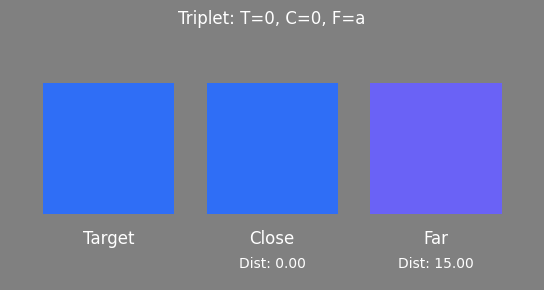

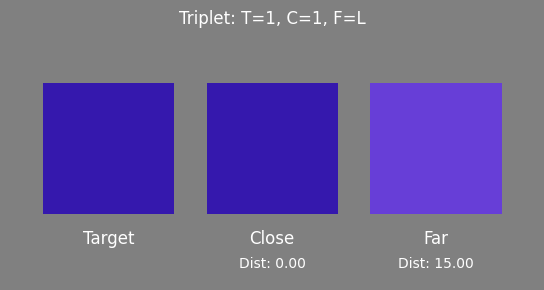

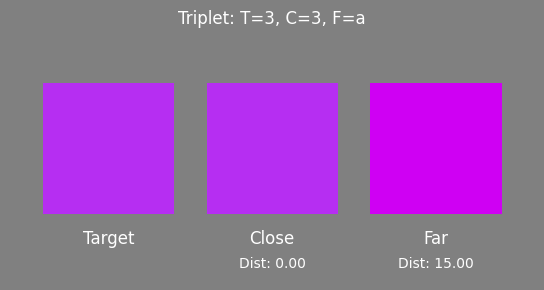

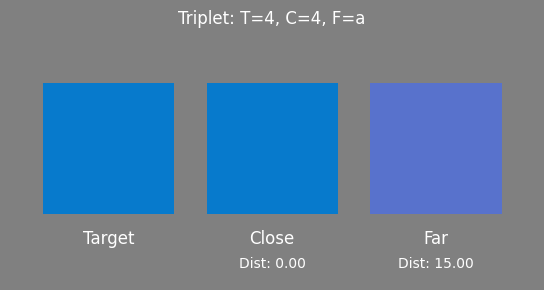

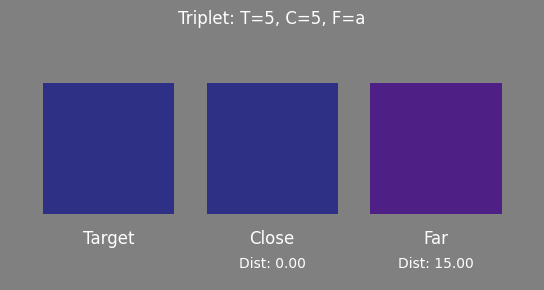

...

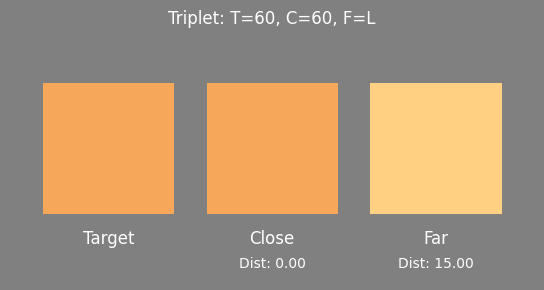

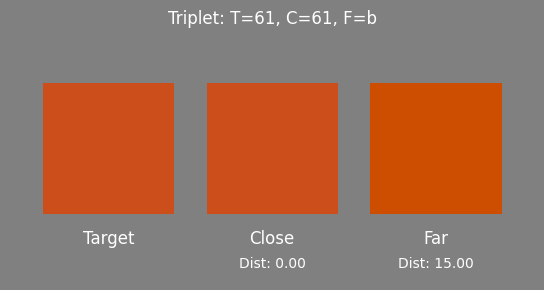

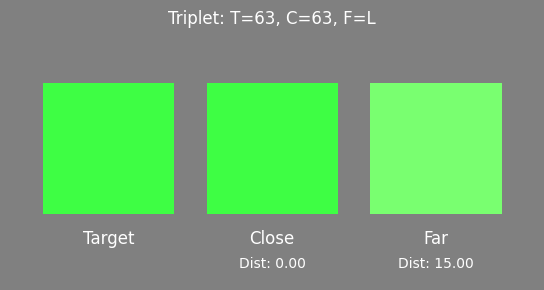

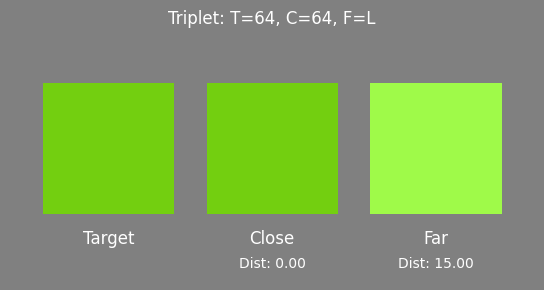

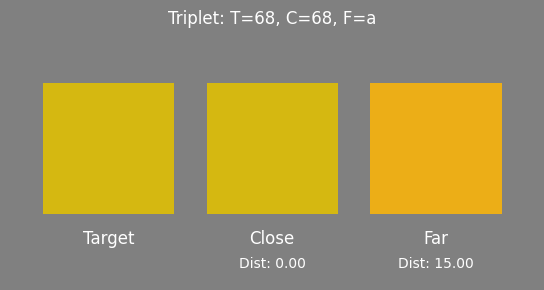

In [290]:

# # You can loop to plot more:
# for i in range(min(35, len(similarity_triplets))): # Plot first 35
#      plot_triplet(triplet_content = similarity_triplets[i], input_mode = 'indices', subsampled_colors_df=subsampled_colors)


a = generate_perceptual_triplets(subsampled_colors, distance_threshold=15, varied_dims = set3)
# You can loop to plot more:
for i in range(min(35, len(a[1]))): # Plot first 35
     plot_triplet(triplet_content = a[0][i], 
                    input_mode = 'coords',
                    meta_for_coords = a[1][i],
                    subsampled_colors_df=subsampled_colors)


        # # You can loop to plot more:  

In [383]:

# 1. Canonical sRGB definitions (0–255) for the 11 basic color terms
PROTOTYPES_SRGB = {
    'white':  (255, 255, 255),
    'black':  (  0,   0,   0),
    'red':    (255,   0,   0),
    'green':  (  0, 128,   0),
    'yellow': (255, 255,   0),
    'blue':   (  0,   0, 255),
    'brown':  (165,  42,  42),
    'purple': (128,   0, 128),
    'pink':   (255, 192, 203),
    'orange': (255, 165,   0),
    'gray':   (128, 128, 128),
}

# 2. Convert each prototype to CIE Lab using 'colour'
#    Chain: sRGB → XYZ → Lab, assuming sRGB colorspace & Illuminant D65.
PROTOTYPES_LAB = {}
for name, (r, g, b) in PROTOTYPES_SRGB.items():
    # Normalise to [0–1]
    rgb01 = np.array([r, g, b]) / 255.0
    # sRGB → XYZ
    xyz = colour.sRGB_to_XYZ(rgb01)
    # XYZ → Lab
    lab = colour.XYZ_to_Lab(xyz)
    PROTOTYPES_LAB[name] = lab  # lab is an ndarray [L*, a*, b*]

def lab_to_basic_color(lab_tuple):
    """
    Map a CIELAB color (L*, a*, b*) to one of the 11 basic categories
    by nearest ΔE*₇₆ distance.
    
    Parameters
    ----------
    lab_tuple : array-like of length 3
        (L*, a*, b*) coordinates in CIELAB space.
    
    Returns
    -------
    str
        One of: 'white', 'black', 'red', 'green', 'yellow',
                'blue', 'brown', 'purple', 'pink', 'orange', 'gray'.
    """
    target = np.asarray(lab_tuple, dtype=float)
    best_cat = None
    best_dist = np.inf
    for name, proto_lab in PROTOTYPES_LAB.items():
        # Euclidean distance in Lab
        dist = np.linalg.norm(target - proto_lab)
        if dist < best_dist:
            best_dist = dist
            best_cat = name
    return best_cat

In [431]:

def generate_orthogonal_triplets_in_plane(
    subsampled_colors_df: pd.DataFrame,
    plane_normal_axis_per_target: list,
    distance_target_to_close: float,
    distance_target_to_far: float,
    max_retries_per_target: int = 20 # Max attempts to find category-distinct triplets
):
    """
    Generates triplets of (target, close, far) LAB color coordinates where
    T, C, F lie in a 2D plane, vectors T->C and T->F are orthogonal,
    and T, C, F belong to different basic color categories.

    For each target color in subsampled_colors_df:
    - Target (T) is the color from the DataFrame.
    - Close (C) and Far (F) points are computed.
    - T, C, and F lie in a 2D plane. The axis normal to this plane (i.e., the
      coordinate that remains constant) is specified by the corresponding entry
      in `plane_normal_axis_per_target`.
    - The vector from T to C and the vector from T to F are orthogonal in this plane.
    - dist(T, C) = distance_target_to_close
    - dist(T, F) = distance_target_to_far
    - Basic color categories of T, C, F must be unique.
    - The set of categories {T_cat, C_cat, F_cat} cannot be {'purple', 'black', 'blue'}.

    Parameters:
    -----------
    subsampled_colors_df : pd.DataFrame
        DataFrame containing color coordinates. Must include 'L', 'a', 'b',
        and 'color_index' columns.
    plane_normal_axis_per_target : list, pd.Series, or np.ndarray
        A list or array-like of strings ('L', 'a', or 'b'), one for each row in
        subsampled_colors_df. Specifies the axis normal to the plane of T,C,F.
    distance_target_to_close : float
        The Euclidean distance from the target color to the 'close' color.
    distance_target_to_far : float
        The Euclidean distance from the target color to the 'far' color.
    max_retries_per_target : int, optional
        Maximum number of attempts to find a triplet satisfying the color category
        constraint for each target color. Defaults to 20.

    Returns:
    --------
    output_triplets : list
        A list of tuples, where each tuple contains the LAB coordinates for the
        (target, close, far) colors. Each coordinate set is a NumPy array [L, a, b].
    output_triplet_meta : list
        A list of tuples containing metadata for each triplet. Each tuple is
        (target_color_index, "computed", plane_normal_axis_name).
    """
    rng = Random(42)  # Set a seed for reproducibility within this function

    required_cols = ['L', 'a', 'b', 'color_index']
    if not all(col in subsampled_colors_df.columns for col in required_cols):
        raise ValueError(f"Input DataFrame must contain columns: {required_cols}")

    if not isinstance(plane_normal_axis_per_target, list):
        plane_normal_axis_list = list(plane_normal_axis_per_target)
    else:
        plane_normal_axis_list = plane_normal_axis_per_target

    if len(subsampled_colors_df) != len(plane_normal_axis_list):
        raise ValueError(
            "Length of subsampled_colors_df and plane_normal_axis_per_target must be the same."
        )

    output_triplets = []
    output_triplet_meta = []
    
    forbidden_category_combo = {'purple', 'black', 'blue'}

    for i, (_df_idx, target_row) in enumerate(subsampled_colors_df.iterrows()):
        target_lab_coords = target_row[['L', 'a', 'b']].values.astype(float)
        target_color_id = target_row['color_index']
        target_category = lab_to_basic_color(target_lab_coords)
        
        current_plane_normal_axis = plane_normal_axis_list[i]
        
        triplet_found_for_target = False
        for retry_count in range(max_retries_per_target):
            # Generate a random angle for the T-C vector in the 2D plane
            angle_tc_in_plane = rng.uniform(0, 2 * math.pi)
            
            # Components of the unit vector for T-C in the 2D plane
            tc_dir_plane_coord1 = math.cos(angle_tc_in_plane)
            tc_dir_plane_coord2 = math.sin(angle_tc_in_plane)
            
            # Components of the unit vector for T-F in the 2D plane (orthogonal to T-C)
            if rng.choice([True, False]): # Randomly choose +90 or -90 deg rotation
                tf_dir_plane_coord1 = -tc_dir_plane_coord2
                tf_dir_plane_coord2 = tc_dir_plane_coord1
            else:
                tf_dir_plane_coord1 = tc_dir_plane_coord2
                tf_dir_plane_coord2 = -tc_dir_plane_coord1
                
            close_lab_coords = np.copy(target_lab_coords)
            far_lab_coords = np.copy(target_lab_coords)
            
            if current_plane_normal_axis == 'L':
                close_lab_coords[1] = target_lab_coords[1] + distance_target_to_close * tc_dir_plane_coord1
                close_lab_coords[2] = target_lab_coords[2] + distance_target_to_close * tc_dir_plane_coord2
                far_lab_coords[1] = target_lab_coords[1] + distance_target_to_far * tf_dir_plane_coord1
                far_lab_coords[2] = target_lab_coords[2] + distance_target_to_far * tf_dir_plane_coord2
            elif current_plane_normal_axis == 'a':
                close_lab_coords[0] = target_lab_coords[0] + distance_target_to_close * tc_dir_plane_coord1
                close_lab_coords[2] = target_lab_coords[2] + distance_target_to_close * tc_dir_plane_coord2
                far_lab_coords[0] = target_lab_coords[0] + distance_target_to_far * tf_dir_plane_coord1
                far_lab_coords[2] = target_lab_coords[2] + distance_target_to_far * tf_dir_plane_coord2
            elif current_plane_normal_axis == 'b':
                close_lab_coords[0] = target_lab_coords[0] + distance_target_to_close * tc_dir_plane_coord1
                close_lab_coords[1] = target_lab_coords[1] + distance_target_to_close * tc_dir_plane_coord2
                far_lab_coords[0] = target_lab_coords[0] + distance_target_to_far * tf_dir_plane_coord1
                far_lab_coords[1] = target_lab_coords[1] + distance_target_to_far * tf_dir_plane_coord2
            else:
                raise ValueError(
                    f"Invalid dimension '{current_plane_normal_axis}' in plane_normal_axis_per_target. Must be 'L', 'a', or 'b'."
                )

            close_category = lab_to_basic_color(close_lab_coords)
            far_category = lab_to_basic_color(far_lab_coords)

            current_categories_set = {target_category, close_category, far_category}

            # Check if all three categories are unique AND the forbidden combination is not present
            if len(current_categories_set) == 3 and not forbidden_category_combo.issubset(current_categories_set):
                output_triplets.append(
                    (np.copy(target_lab_coords), close_lab_coords, far_lab_coords)
                )
                output_triplet_meta.append(
                    (target_color_id, "computed", current_plane_normal_axis)
                )
                triplet_found_for_target = True
                print(target_category, close_category, far_category)
                break # Found a valid triplet for this target
        
        if not triplet_found_for_target:
            print(f"Warning: Could not find category-distinct triplet for target color_index {target_color_id} "
                  f"(category: {target_category}, normal axis: {current_plane_normal_axis}) after {max_retries_per_target} retries. Skipping.")
            
    return output_triplets, output_triplet_meta

In [457]:

def generate_distinct_color_category_triplets(
    subsampled_colors_df: pd.DataFrame,
    plane_normal_axis_per_target: list, # New parameter
    distance_from_target: float,
    max_retries_per_target: int = 30,
    seed: int = 42
):
    """
    Generates triplets of (target, close, far) LAB color coordinates.

    - Target (T) is a color from subsampled_colors_df.
    - Close (C) and Far (F) points are computed by moving from T by 
      `distance_from_target`. The displacement vectors T->C and T->F are 
      orthogonal to each other and lie in a 2D plane.
    - This plane is defined by holding one of the LAB coordinates (L, a, or b) 
      constant, as specified by the corresponding entry in `plane_normal_axis_per_target` 
      for each target color. 
    - The orientation of the (T->C, T->F) pair within this plane is determined as follows:
        - If the projection of the vector OT (Origin to Target) onto the 2D plane is non-zero,
          the T->C and T->F vectors are oriented at +45 and -45 degrees relative to this projection.
        - If the projection of OT is zero (e.g., target is achromatic and plane is a-b),
          the orientation of T->C and T->F is randomized.
    - The three colors (T, C, F) must belong to different basic color categories 
      (e.g., 'red', 'blue', 'green').
    - The specific set of categories {'purple', 'black', 'blue'} is disallowed for the triplet.

    Parameters:
    -----------
    subsampled_colors_df : pd.DataFrame
        DataFrame containing color coordinates. Must include 'L', 'a', 'b',
        and 'color_index' columns.
    plane_normal_axis_per_target : list
        A list of strings ('L', 'a', 'b') or integers (0, 1, 2), one for each 
        row in subsampled_colors_df. Specifies the axis normal to the plane 
        of T,C,F (i.e., the coordinate that remains constant).
        0 maps to 'L', 1 to 'a', 2 to 'b'.
    distance_from_target : float
        The Euclidean distance in LAB space from the target color to the 'close'
        color, and from the target color to the 'far' color.
    max_retries_per_target : int, optional
        Maximum number of attempts to find a triplet satisfying the color category
        constraint for each target color. Defaults to 30.
    seed : int, optional
        Random seed for reproducibility. Defaults to 42.

    Returns:
    --------
    output_triplets : list
        A list of tuples, where each tuple contains the LAB coordinates for the
        (target, close, far) colors. Each coordinate set is a NumPy array [L, a, b].
    output_triplet_meta : list
        A list of tuples containing metadata for each triplet. Each tuple is
        (target_color_index, close_color_category, far_color_category, plane_normal_axis_name).
    """
    rng = Random(seed)

    required_cols = ['L', 'a', 'b', 'color_index']
    if not all(col in subsampled_colors_df.columns for col in required_cols):
        raise ValueError(f"Input DataFrame must contain columns: {required_cols}")

    if len(subsampled_colors_df) != len(plane_normal_axis_per_target):
        raise ValueError(
            "Length of subsampled_colors_df and plane_normal_axis_per_target must be the same."
        )

    output_triplets = []
    output_triplet_meta = []
    
    forbidden_category_combo = {'purple', 'black', 'blue'} 

    if 'lab_to_basic_color' not in globals():
        raise NameError("The function 'lab_to_basic_color' is not defined in the global scope. "
                        "Please ensure it is defined (e.g., by running cell '55cf6cc0').")

    dim_map = {0: 'L', 1: 'a', 2: 'b', 'L': 'L', 'a': 'a', 'b': 'b'}

    for i, (_df_idx, target_row) in enumerate(subsampled_colors_df.iterrows()):
        target_lab_coords = target_row[['L', 'a', 'b']].values.astype(float)
        target_color_id = target_row['color_index']
        target_category = lab_to_basic_color(target_lab_coords)
        
        current_plane_normal_axis_spec = plane_normal_axis_per_target[i]
        try:
            current_plane_normal_axis_name = dim_map[current_plane_normal_axis_spec]
        except KeyError:
            raise ValueError(
                f"Invalid value '{current_plane_normal_axis_spec}' in plane_normal_axis_per_target. "
                "Must be 'L', 'a', 'b', or 0, 1, 2."
            )
            
        triplet_found_for_target = False
        for _retry_count in range(max_retries_per_target):
            
            # Determine the coordinates of the target T in the 2D plane (projection of OT)
            ot_plane_coord1, ot_plane_coord2 = 0.0, 0.0
            if current_plane_normal_axis_name == 'L': # Plane is a-b
                ot_plane_coord1 = target_lab_coords[1]  # a_t
                ot_plane_coord2 = target_lab_coords[2]  # b_t
            elif current_plane_normal_axis_name == 'a': # Plane is L-b
                ot_plane_coord1 = target_lab_coords[0]  # L_t
                ot_plane_coord2 = target_lab_coords[2]  # b_t
            elif current_plane_normal_axis_name == 'b': # Plane is L-a
                ot_plane_coord1 = target_lab_coords[0]  # L_t
                ot_plane_coord2 = target_lab_coords[1]  # a_t

            angle_tc_in_plane, angle_tf_in_plane = 0.0, 0.0

            # Check if the projection of OT onto the plane is (close to) a zero vector
            if np.isclose(ot_plane_coord1, 0) and np.isclose(ot_plane_coord2, 0):
                # OT_plane is zero. Reference direction for "45 degrees away" is undefined.
                # Revert to fully random orientation for TC vector, TF will be orthogonal.
                angle_tc_in_plane = rng.uniform(0, 2 * np.pi)
                if rng.choice([True, False]): # Randomly choose +90 or -90 deg for TF relative to TC
                    angle_tf_in_plane = angle_tc_in_plane + np.pi / 2
                else:
                    angle_tf_in_plane = angle_tc_in_plane - np.pi / 2
            else:
                # OT_plane is non-zero. Calculate its angle.
                angle_ot_plane = np.arctan2(ot_plane_coord2, ot_plane_coord1)
                
                # TC and TF vectors are +/- 45 degrees from angle_ot_plane.
                # Randomly assign which displacement vector (TC or TF) gets the +45 deg offset.
                if rng.choice([True, False]):
                    angle_tc_in_plane = angle_ot_plane + np.pi / 4
                    angle_tf_in_plane = angle_ot_plane - np.pi / 4 
                else:
                    angle_tc_in_plane = angle_ot_plane - np.pi / 4
                    angle_tf_in_plane = angle_ot_plane + np.pi / 4
            
            # Components of the unit vector for T-C in the 2D plane
            tc_dir_plane_coord1 = np.cos(angle_tc_in_plane)
            tc_dir_plane_coord2 = np.sin(angle_tc_in_plane)
            
            # Components of the unit vector for T-F in the 2D plane
            tf_dir_plane_coord1 = np.cos(angle_tf_in_plane)
            tf_dir_plane_coord2 = np.sin(angle_tf_in_plane)
                
            close_lab_coords = np.copy(target_lab_coords)
            far_lab_coords = np.copy(target_lab_coords)
            
            if current_plane_normal_axis_name == 'L': # Plane is a-b, normal is L (index 0)
                close_lab_coords[1] = target_lab_coords[1] + distance_from_target * tc_dir_plane_coord1 # delta_a
                close_lab_coords[2] = target_lab_coords[2] + distance_from_target * tc_dir_plane_coord2 # delta_b
                far_lab_coords[1] = target_lab_coords[1] + distance_from_target * tf_dir_plane_coord1   # delta_a
                far_lab_coords[2] = target_lab_coords[2] + distance_from_target * tf_dir_plane_coord2   # delta_b
            elif current_plane_normal_axis_name == 'a': # Plane is L-b, normal is a (index 1)
                close_lab_coords[0] = target_lab_coords[0] + distance_from_target * tc_dir_plane_coord1 # delta_L
                close_lab_coords[2] = target_lab_coords[2] + distance_from_target * tc_dir_plane_coord2 # delta_b
                far_lab_coords[0] = target_lab_coords[0] + distance_from_target * tf_dir_plane_coord1   # delta_L
                far_lab_coords[2] = target_lab_coords[2] + distance_from_target * tf_dir_plane_coord2   # delta_b
            elif current_plane_normal_axis_name == 'b': # Plane is L-a, normal is b (index 2)
                close_lab_coords[0] = target_lab_coords[0] + distance_from_target * tc_dir_plane_coord1 # delta_L
                close_lab_coords[1] = target_lab_coords[1] + distance_from_target * tc_dir_plane_coord2 # delta_a
                far_lab_coords[0] = target_lab_coords[0] + distance_from_target * tf_dir_plane_coord1   # delta_L
                far_lab_coords[1] = target_lab_coords[1] + distance_from_target * tf_dir_plane_coord2   # delta_a
            
            close_lab_coords[0] = np.clip(close_lab_coords[0], 0, 100)
            far_lab_coords[0] = np.clip(far_lab_coords[0], 0, 100)

            close_category = lab_to_basic_color(close_lab_coords)
            far_category = lab_to_basic_color(far_lab_coords)

            current_categories_set = {target_category, close_category, far_category}

            if len(current_categories_set) == 3 and not forbidden_category_combo.issubset(current_categories_set):
                output_triplets.append(
                    (np.copy(target_lab_coords), np.copy(close_lab_coords), np.copy(far_lab_coords))
                )
                output_triplet_meta.append(
                    (target_color_id, close_category, far_category) # Added plane normal to meta
                )
                triplet_found_for_target = True
                break 
        
        if not triplet_found_for_target:
            print(f"Warning: Could not find category-distinct triplet for target color_index {target_color_id} "
                  f"(category: {target_category}, plane_normal: {current_plane_normal_axis_name}) "
                  f"after {max_retries_per_target} retries. Skipping.")
            
    return output_triplets, output_triplet_meta

In [468]:
new_collinear_triplets, new_collinear_meta = generate_distinct_color_category_triplets(
       subsampled_colors_df = subsampled_colors,
    plane_normal_axis_per_target=  set1, # New parameter
    distance_from_target = 300,
    max_retries_per_target=100
    )
print(len(new_collinear_triplets))

23


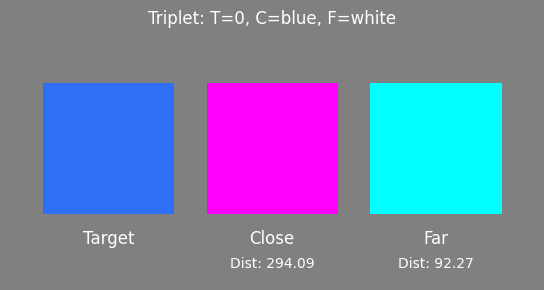

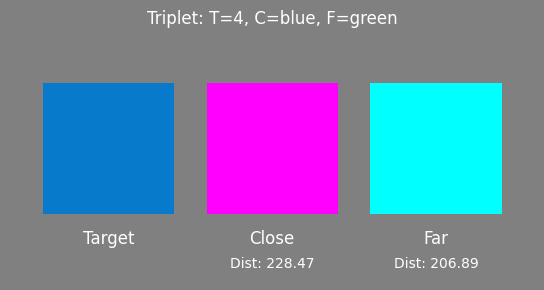

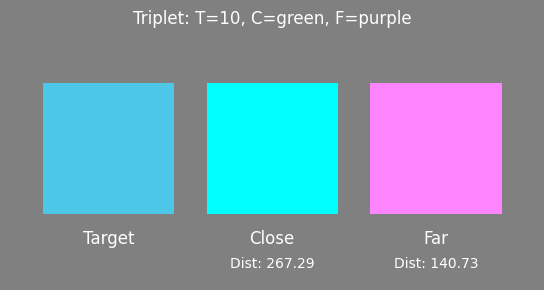

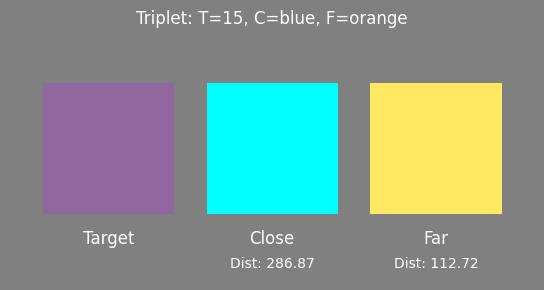

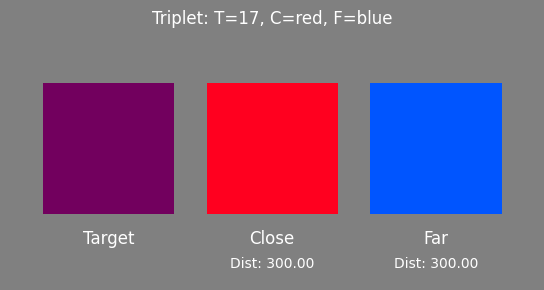

...

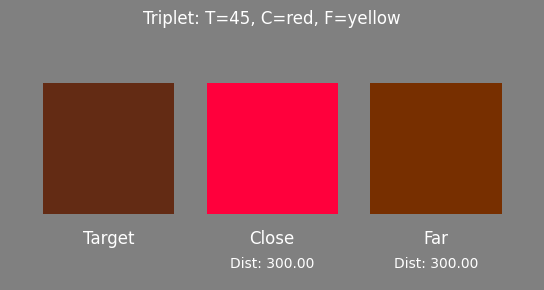

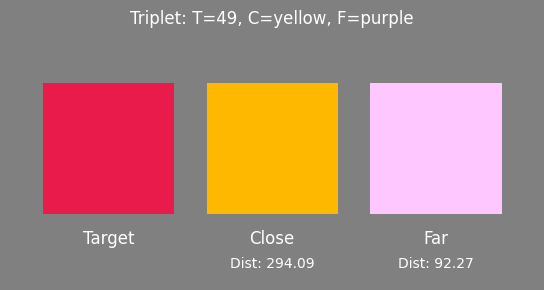

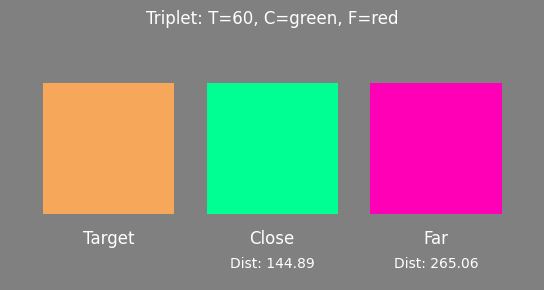

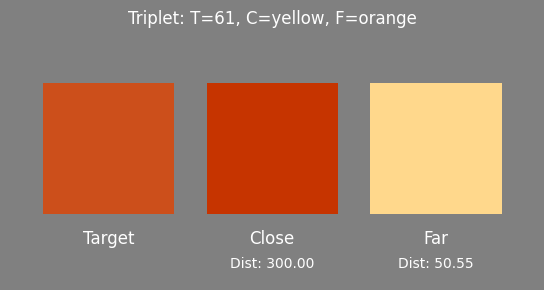

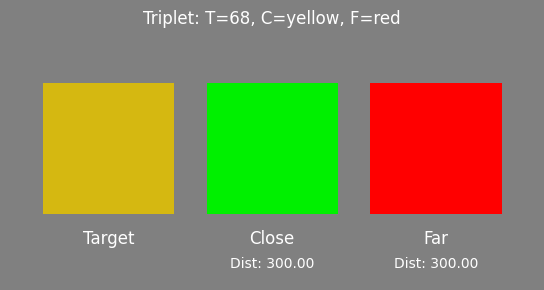

In [470]:
for i in range(min(35, len(new_collinear_triplets))): # Plot first 35
     plot_triplet(triplet_content = new_collinear_triplets[i], 
                    input_mode = 'coords',
                    meta_for_coords = new_collinear_meta[i],
                    subsampled_colors_df=subsampled_colors)



[(0, None, None, 'b'),
 (1, None, None, 'b'),
 (3, None, None, 'L'),
 (4, None, None, 'b'),
 (5, None, None, 'L'),
 (8, None, None, 'L'),
 (10, None, None, 'b'),
 (11, None, None, 'L'),
 (13, None, None, 'L'),
 (15, None, None, 'a'),
 (17, None, None, 'L'),
 (19, None, None, 'L'),
 (20, None, None, 'a'),
 (21, None, None, 'L'),
 (24, None, None, 'a'),
 (25, None, None, 'b'),
 (28, None, None, 'b'),
 (30, None, None, 'b'),
 (32, None, None, 'L'),
 (33, None, None, 'a'),
 (35, None, None, 'b'),
 (37, None, None, 'a'),
 (38, None, None, 'b'),
 (41, None, None, 'b'),
 (42, None, None, 'L'),
 (44, None, None, 'a'),
 (45, None, None, 'L'),
 (49, None, None, 'a'),
 (50, None, None, 'L'),
 (55, None, None, 'L'),
 (60, None, None, 'b'),
 (61, None, None, 'a'),
 (63, None, None, 'b'),
 (64, None, None, 'b'),
 (68, None, None, 'L')]

In [106]:
cc_assoc_ratings

,0,1,2,3,4,5,6,7,8,9,...,62,63,64,65,66,67,68,69,70,concept
0,0.649375,0.461193,0.473295,0.477159,0.631136,0.500284,0.524091,0.296591,0.484205,0.470398,...,0.415682,0.589432,0.550000,0.585739,0.513864,0.586136,0.565795,0.643239,0.556534,above
1,0.225650,0.323600,0.223300,0.304400,0.185750,0.331800,0.218850,0.363900,0.219550,0.335300,...,0.825300,0.197250,0.246050,0.193250,0.256200,0.200150,0.277350,0.301250,0.461400,angry
2,0.758500,0.575778,0.232556,0.213278,0.764333,0.613500,0.364667,0.192444,0.207889,0.265444,...,0.237333,0.303222,0.320889,0.347389,0.357056,0.449611,0.595111,0.706111,0.556611,beach
3,0.426080,0.529886,0.427386,0.392727,0.494318,0.560682,0.484432,0.522216,0.385568,0.330625,...,0.486023,0.345682,0.360398,0.306477,0.396648,0.308580,0.343352,0.278352,0.408409,below
4,0.489489,0.409148,0.431875,0.429943,0.473239,0.437330,0.508920,0.474091,0.454034,0.437784,...,0.384318,0.418011,0.460682,0.432273,0.443523,0.419659,0.415568,0.467273,0.437443,beside
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
65,0.497250,0.464750,0.441050,0.435850,0.528500,0.477200,0.529500,0.399500,0.442350,0.425700,...,0.394800,0.388350,0.453500,0.414800,0.426300,0.425050,0.514150,0.563800,0.535750,reliability
66,0.548950,0.483150,0.453800,0.331050,0.570600,0.526150,0.507250,0.439200,0.400000,0.370150,...,0.302250,0.462350,0.535750,0.481350,0.448100,0.538900,0.520000,0.521600,0.465800,safety
67,0.595865,0.697452,0.584327,0.400337,0.567067,0.790721,0.691827,0.613702,0.479087,0.276442,...,0.152740,0.213317,0.240240,0.215192,0.253558,0.221538,0.244567,0.263702,0.243990,sleeping
68,0.516400,0.422200,0.449800,0.494750,0.453200,0.337400,0.414300,0.324400,0.412450,0.604050,...,0.718650,0.719750,0.682550,0.695450,0.533700,0.609500,0.601450,0.603550,0.596400,speed


In [108]:
subsampled_colors

,L,a,b,R,G,B,x,y,Y,v_index,color_index
0,50.0,28.891,-73.589,0.029,0.156,0.922,0.178,0.140,0.184,V1,0
1,25.0,53.857,-72.280,0.036,0.009,0.417,0.174,0.083,0.044,V2,1
2,50.0,78.822,-70.972,0.470,0.028,0.890,0.259,0.131,0.184,V4,3
3,50.0,2.617,-49.931,0.002,0.196,0.604,0.187,0.192,0.184,V5,4
4,25.0,27.583,-48.623,0.027,0.030,0.239,0.191,0.130,0.044,V6,5
5,50.0,52.548,-47.315,0.376,0.087,0.580,0.279,0.176,0.184,V9,8
6,75.0,-23.657,-26.274,0.075,0.571,0.807,0.224,0.284,0.483,V11,10
7,25.0,1.308,-24.966,0.012,0.046,0.119,0.208,0.214,0.044,V12,11
8,75.0,1.308,-24.966,0.352,0.491,0.793,0.263,0.274,0.483,V14,13
9,50.0,26.274,-23.657,0.280,0.139,0.349,0.298,0.240,0.184,V16,15


In [260]:
def generate_target_concept_contrast_triplets(subsampled_colors_df, 
                                              cc_assoc_ratings_df, 
                                              min_rating_difference_threshold,
                                              close_concept_rank_per_target, # New parameter
                                              max_rating_difference_threshold=None): # Added from notebook version
    """
    Generates triplets of (target_color_index, close_concept_word, far_concept_word).

    For each target color in subsampled_colors_df:
    1. Identifies the column in cc_assoc_ratings_df corresponding to the target color's index.
    2. The 'close_concept_word' is selected based on its association ranking for the target color,
       as specified by 'close_concept_rank_per_target'. A concept used as 'close' once
       will not be used as 'close' again. If the preferred rank is taken, it tries the next 
       available ranks (up to a few additional attempts).
    3. The 'far_concept_word' is a concept whose association rating for the target color is
       at least 'min_rating_difference_threshold' (and optionally at most 
       'max_rating_difference_threshold') different from the 'close_concept_word's rating.
       One eligible 'far' concept is randomly sampled from the potential candidates.

    Parameters:
    -----------
    subsampled_colors_df : pd.DataFrame
        DataFrame containing the subset of colors. Must include the 'color_index' column.
    cc_assoc_ratings_df : pd.DataFrame
        DataFrame containing semantic association ratings. 
        It must have a 'concept' column (or 'concept' as its index).
        Other columns should be color indices (as strings) whose values are association ratings.
    min_rating_difference_threshold : float
        The minimum required absolute difference between the association rating of the 
        'close' concept and the 'far' concept for the target color.
    close_concept_rank_per_target : list of int
        A list of integers (0, 1, or 2), one for each target color in subsampled_colors_df.
        0 means highest associated, 1 means second highest, 2 means third highest.
    max_rating_difference_threshold : float, optional
        The maximum allowed absolute difference between the association rating of the 
        'close' concept and the 'far' concept for the target color.

    Returns:
    --------
    list
        A list of tuples: (target_color_index, close_concept_word, far_concept_word).
    """

    # --- Input Validation and Preparation ---
    rng = np.random.default_rng(42) # Initialize RNG for reproducibility
    if 'color_index' not in subsampled_colors_df.columns:
        raise ValueError("subsampled_colors_df must contain the 'color_index' column.")
    if len(subsampled_colors_df) != len(close_concept_rank_per_target):
        raise ValueError("Length of subsampled_colors_df and close_concept_rank_per_target must be the same.")

    if cc_assoc_ratings_df.index.name == 'concept':
        ratings_df = cc_assoc_ratings_df.reset_index()
    elif 'concept' not in cc_assoc_ratings_df.columns:
        raise ValueError("cc_assoc_ratings_df must have a 'concept' column or 'concept' as its index.")
    else:
        ratings_df = cc_assoc_ratings_df.copy()

    ratings_df.columns = [str(col) if col != 'concept' else 'concept' for col in ratings_df.columns]

    output_triplets = []
    used_close_concepts = set() # To track used close concepts

    for i, (_, target_color_row) in enumerate(subsampled_colors_df.iterrows()):
        target_color_index = target_color_row['color_index']
        target_color_col_name = str(target_color_index)

        if target_color_col_name not in ratings_df.columns:
            continue

        target_color_ratings_series = ratings_df.set_index('concept')[target_color_col_name].sort_values(ascending=False)
        
        if target_color_ratings_series.empty:
            continue

        # --- Select 'close' concept based on rank and availability ---
        preferred_rank = close_concept_rank_per_target[i]
        selected_close_concept_word = None
        rating_of_selected_close_concept = None
        
        # Try preferred rank, then subsequent ranks (e.g., up to 10 attempts)
        for rank_offset in range(10): 
            current_rank_attempt = preferred_rank + rank_offset
            if current_rank_attempt < len(target_color_ratings_series):
                candidate_concept = target_color_ratings_series.index[current_rank_attempt]
                if candidate_concept not in used_close_concepts:
                    selected_close_concept_word = candidate_concept
                    rating_of_selected_close_concept = target_color_ratings_series.iloc[current_rank_attempt]
                    used_close_concepts.add(selected_close_concept_word)
                    break # Found a suitable close concept
            else:
                break # No more concepts to try at higher ranks for this target

        if selected_close_concept_word is None:
            # print(f"Info: Could not find an unused 'close' concept for target color {target_color_index} with preferred rank {preferred_rank} and alternatives.")
            continue # Skip to next target color

        # --- Find 'far' concept ---
        potential_far_concepts = []
       
        for concept, rating in target_color_ratings_series.items():
            if concept == selected_close_concept_word:
                continue 

            rating_difference = rating_of_selected_close_concept - rating
            
            passes_min_threshold = rating_difference >= min_rating_difference_threshold
            passes_max_threshold = True # Assume it passes if no max threshold is given
            if max_rating_difference_threshold is not None:
                passes_max_threshold = rating_difference <= max_rating_difference_threshold
            
            if passes_min_threshold and passes_max_threshold:
                potential_far_concepts.append({'concept': concept, 'rating_diff': rating_difference, 'rating': rating})
        
        if not potential_far_concepts:
            # print(f"Info: No 'far' concept found for target color {target_color_index} (close concept: {selected_close_concept_word}).")
            continue

       
        # Randomly sample one of the potential 'far' concepts
        best_far_candidate = rng.choice(potential_far_concepts)
        far_concept_word = best_far_candidate['concept']
        
        output_triplets.append((target_color_index, selected_close_concept_word, far_concept_word))

    return output_triplets

In [276]:

def plot_color_concept_triplet(semantic_triplet, 
                               subsampled_colors_df, 
                               cc_assoc_ratings_df, 
                               background_color='gray'): # Changed default for better text visibility
    """
    Plots a target color square alongside a 'close' and a 'far' concept word,
    displaying their association ratings with the target color.

    Parameters:
    -----------
    semantic_triplet : tuple
        A tuple (target_color_index, close_concept_word, far_concept_word).
    subsampled_colors_df : pd.DataFrame
        DataFrame containing color coordinates. Must include 'R', 'G', 'B', 
        'L', 'a', 'b', and 'color_index' columns. Assumes RGB is linear.
    cc_assoc_ratings_df : pd.DataFrame
        DataFrame containing semantic association ratings. 
        Must have a 'concept' column (or 'concept' as its index).
        Other columns should be color indices (as strings) whose values are association ratings.
    background_color : str, optional
        Background color for the plot. Defaults to 'lightgray'.
    """
    
    target_color_index, close_concept_word, far_concept_word = semantic_triplet

    # --- 1. Retrieve Target Color Data ---
    try:
        target_row = subsampled_colors_df.loc[subsampled_colors_df['color_index'] == target_color_index].iloc[0]
        target_rgb_linear = target_row[['R', 'G', 'B']].values.astype(float)
        # target_lab = target_row[['L', 'a', 'b']].values.astype(float) # For context if needed later
    except IndexError:
        print(f"Error: Target color index {target_color_index} not found in subsampled_colors_df.")
        return
    except KeyError as e:
        print(f"Error: Missing required RGB/color_index column in subsampled_colors_df: {e}.")
        return

    # Convert linear RGB to sRGB (non-linear) for display and clip
    target_rgb_display = colour.cctf_encoding(np.clip(target_rgb_linear, 0, 1))

    # --- 2. Retrieve Association Ratings ---
    # Prepare cc_assoc_ratings_df (similar to generate_target_concept_contrast_triplets)
    if cc_assoc_ratings_df.index.name == 'concept':
        ratings_df_processed = cc_assoc_ratings_df.reset_index()
    elif 'concept' not in cc_assoc_ratings_df.columns:
        print("Error: cc_assoc_ratings_df must have a 'concept' column or 'concept' as its index.")
        return
    else:
        ratings_df_processed = cc_assoc_ratings_df.copy()
    
    ratings_df_processed.columns = [str(col) if col != 'concept' else 'concept' for col in ratings_df_processed.columns]
    target_color_col_name = str(target_color_index)

    rating_close_concept = np.nan
    rating_far_concept = np.nan

    if target_color_col_name not in ratings_df_processed.columns:
        print(f"Error: Column for target color index {target_color_index} not found in cc_assoc_ratings_df.")
    else:
        try:
            ratings_for_target_series = ratings_df_processed.set_index('concept')[target_color_col_name]
            rating_close_concept = ratings_for_target_series.get(close_concept_word, np.nan)
            rating_far_concept = ratings_for_target_series.get(far_concept_word, np.nan)
        except KeyError as e:
            print(f"Error accessing ratings: {e}")


    # --- 3. Create Plot ---
    fig, ax = plt.subplots(1, 1, figsize=(5, 2.5)) # Adjusted figsize for text
    fig.patch.set_facecolor(background_color)
    ax.set_facecolor(background_color)

    # Define item properties
    item_width = 0.25 # Relative width for each item (1 color, 2 text blocks)
    spacing = 0.05
    
    # Positions (normalized 0 to 1 for the axis)
    # Total width: 3*item_width + 2*spacing. Let's center this.
    total_content_width = 3 * item_width + 2 * spacing
    start_x = (1 - total_content_width) / 2

    target_x_pos = start_x
    close_concept_x_pos = target_x_pos + item_width + spacing
    far_concept_x_pos = close_concept_x_pos + item_width + spacing
    
    square_size = 0.25 # Relative to item_width, for the color square
    y_center = 0.5 # Vertical center of the plot area

    # Plot Target Color Square
    color_square_y = y_center - (square_size / 2) # Align square center with y_center
    target_square = patches.Rectangle(
        (target_x_pos + (item_width - square_size)/2, color_square_y-.1), 
        width=square_size, 
        height = square_size+.10, 
        facecolor=target_rgb_display,
        # edgecolor='black' if background_color == 'white' else 'darkgray' # Edge for visibility
    )
    ax.add_patch(target_square)

    # Text properties
    text_color = 'black' if background_color != 'black' else 'white'
    label_y_offset = 0.2 # Below the center
    rating_y_offset = -0.10 # Further below for rating

    # Target Label
    ax.text(target_x_pos + item_width / 2, y_center + label_y_offset, 'Target Color', 
            ha='center', va='center', fontsize=12, color=text_color)

    # Close Concept Text and Rating
    ax.text(close_concept_x_pos + item_width / 2, y_center, close_concept_word, 
            ha='center', va='center', fontsize=14, color=text_color, wrap=True)
    ax.text(close_concept_x_pos + item_width / 2, y_center + label_y_offset, 'Close Concept', 
            ha='center', va='center', fontsize=12, color=text_color)
    ax.text(close_concept_x_pos + item_width / 2, y_center + rating_y_offset, f'Rating: {rating_close_concept:.2f}', 
            ha='center', va='center', fontsize=10, color=text_color)

    # Far Concept Text and Rating
    ax.text(far_concept_x_pos + item_width / 2, y_center, far_concept_word, 
            ha='center', va='center', fontsize=14, color=text_color, wrap=True)
    ax.text(far_concept_x_pos + item_width / 2, y_center + label_y_offset, 'Far Concept', 
            ha='center', va='center', fontsize=12, color=text_color)
    ax.text(far_concept_x_pos + item_width / 2, y_center + rating_y_offset, f'Rating: {rating_far_concept:.2f}', 
            ha='center', va='center', fontsize=10, color=text_color)

    # Clean up axes
    ax.set_xlim(0, 1)
    ax.set_ylim(0, 1)
    ax.axis('off')

    plt.suptitle(f"Target Color Index {target_color_index}", 
                 color=text_color, fontsize=14)
    # plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Add padding for suptitle
    plt.show()

In [288]:

new_semantic_triplets = generate_target_concept_contrast_triplets(
        subsampled_colors, 
        cc_assoc_ratings, 
        min_rating_difference_threshold=0.35, # Example threshold
        max_rating_difference_threshold=0.8,
        close_concept_rank_per_target = set2_num
    )
print(len(new_semantic_triplets))

35


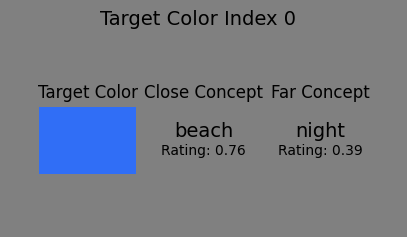

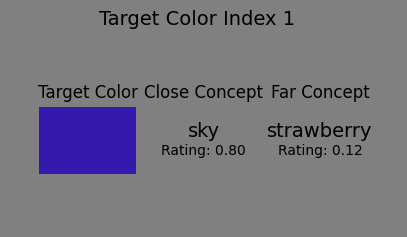

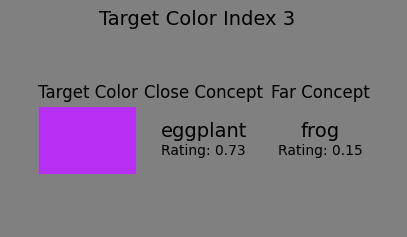

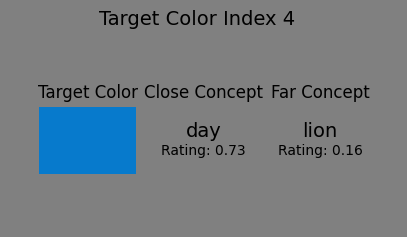

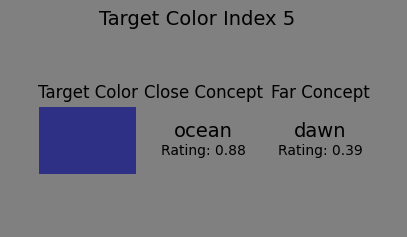

...

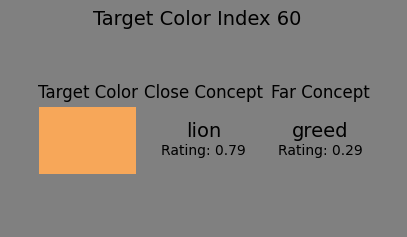

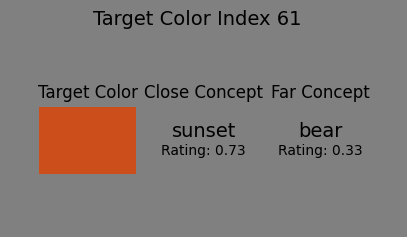

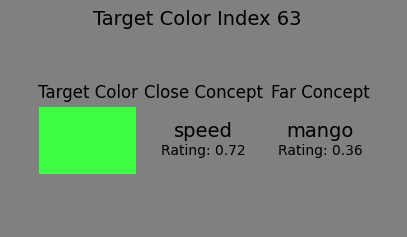

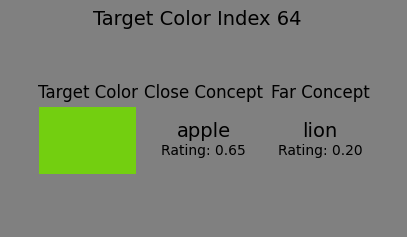

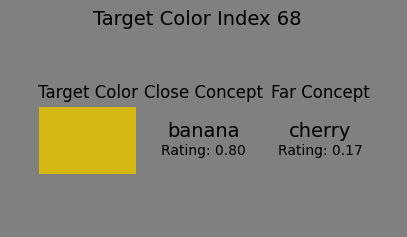

In [289]:
for i in range(min(35, len(new_semantic_triplets))):
        plot_color_concept_triplet(
            new_semantic_triplets[i],
            subsampled_colors,
            cc_assoc_ratings
        )

In [ ]:
uw71_coords_original

,v_index,color_index,L,a,b,C,H,r_rgb,g_rgb,b_rgb,r255,g255,b255,color_hex
0,V1,0,50,28.891,-73.589,79.057136,291.434944,0.18536,0.431390,0.964970,47.26680,110.004450,246.067350,#2f6ef6
1,V2,1,25,53.857,-72.280,90.138642,306.690392,0.20878,0.093277,0.677550,53.23890,23.785635,172.775250,#3518ad
2,V3,2,50,53.857,-72.280,90.138642,306.690392,0.52107,0.343280,0.957410,132.87285,87.536400,244.139550,#8558f4
3,V4,3,50,78.822,-70.972,106.065699,317.999859,0.71554,0.182090,0.950150,182.46270,46.432950,242.288250,#b62ef2
4,V5,4,50,2.617,-49.931,49.999524,273.000031,0.02815,0.479950,0.800070,7.17825,122.387250,204.017850,#077acc
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
66,V67,66,75,-28.891,73.589,79.057136,111.434944,0.66567,0.770750,0.060920,169.74585,196.541250,15.534600,#aac510
67,V68,67,88,-28.891,73.589,79.057136,111.434944,0.81500,0.913800,0.258170,207.82500,233.019000,65.833350,#d0e942
68,V69,68,75,-3.925,74.897,74.999785,93.000011,0.83409,0.720190,0.066708,212.69295,183.648450,17.010540,#d5b811
69,V70,69,88,-3.925,74.897,74.999785,93.000011,0.98973,0.860650,0.257390,252.38115,219.465750,65.634450,#fcdb42


--- Perceptual Distance Matrix (Euclidean in LAB) ---
Shape: (35, 35)
          0          1          3          4          5          8   \
0   0.000000  35.355546  49.999534  35.355679  35.355509  35.355010   
1  35.355546   0.000000  35.354803  61.237369  35.355010  35.354840   
3  49.999534  35.354803   0.000000  79.056472  61.236533  35.355010   
4  35.355679  61.237369  79.056472   0.000000  35.355509  49.999482   
5  35.355509  35.355010  61.236533  35.355509   0.000000  35.354803   

           10         11         13         15  ...          44          45  \
0   75.000010  61.237391  61.237391  50.000533  ...  109.859308  103.077706   
1  103.077506  70.710763  86.602610  61.237391  ...  128.331453  103.077306   
3  114.563767  93.541286  93.541286  70.710689  ...  130.648064  114.564225   
4   43.301001  35.354840  35.354840  35.355010  ...   84.077145   82.914918   
5   75.000103  35.355753  61.237483  35.355546  ...  101.089222   74.999827   

           49          50   

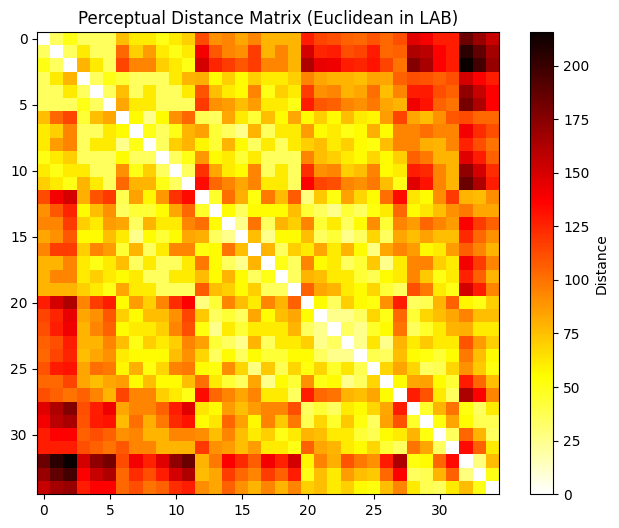

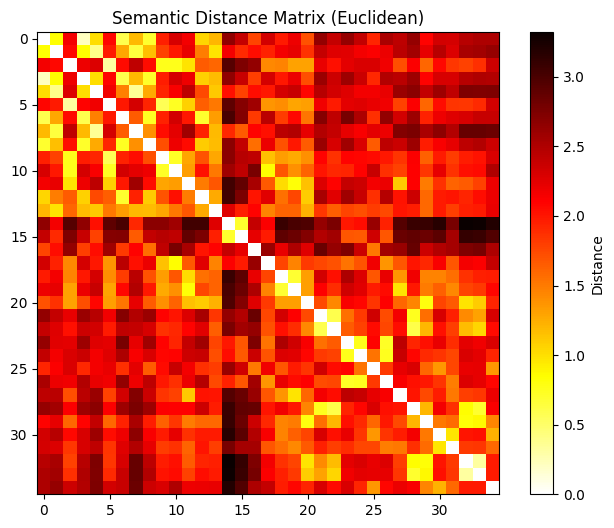

In [ ]:

lab_coords = subsampled_colors[['L', 'a', 'b']].values
color_indices = subsampled_colors['color_index'].tolist() # Get the actual color indices for labeling

# Calculate pairwise Euclidean distances in LAB space
perceptual_dist_condensed = pdist(lab_coords, metric='euclidean')
perceptual_dist_matrix_np = squareform(perceptual_dist_condensed)

# Create a labeled DataFrame
perceptual_dist_matrix = pd.DataFrame(
    perceptual_dist_matrix_np,
    index=color_indices,
    columns=color_indices
)

print("--- Perceptual Distance Matrix (Euclidean in LAB) ---")
print(f"Shape: {perceptual_dist_matrix.shape}")
print(perceptual_dist_matrix.head())
print("-" * 50)
plt.figure(figsize=(8, 6))
plt.imshow(perceptual_dist_matrix, cmap='hot_r', interpolation='nearest')
plt.colorbar(label='Distance')
plt.title('Perceptual Distance Matrix (Euclidean in LAB)')


relevant_color_indices_str = [str(idx) for idx in color_indices]

# Check for missing columns
missing_cols = [idx for idx in relevant_color_indices_str if idx not in cc_assoc_ratings.columns]
if missing_cols:
    raise ValueError(f"Color indices missing as columns in cc_assoc_ratings_df: {missing_cols}")

# Select the relevant columns and set 'concept' as index if it isn't already
if 'concept' in cc_assoc_ratings.columns:
    semantic_vectors_df = cc_assoc_ratings.set_index('concept')[relevant_color_indices_str]
elif cc_assoc_ratings.index.name == 'concept' or isinstance(cc_assoc_ratings.index, pd.Index):
     semantic_vectors_df = cc_assoc_ratings[relevant_color_indices_str]
else:
    print("Warning: 'concept' index/column not found. Using all rows as semantic features.")
    semantic_vectors_df = cc_assoc_ratings[relevant_color_indices_str]

# Transpose so that rows are colors and columns are concepts
# Reindex to ensure the order matches the 'color_indices' list
semantic_vectors_t = semantic_vectors_df.T.loc[relevant_color_indices_str]
semantic_vectors = semantic_vectors_t.values

# --- 2b. Semantic Distance (Cosine) ---

semantic_dist_euclidean_condensed = pdist(semantic_vectors, metric='euclidean')
semantic_dist_euclidean_matrix_np = squareform(semantic_dist_euclidean_condensed)

# Handle potential NaN values if vectors are all zeros (cosine is undefined)
semantic_dist_euclidean_matrix_np = np.nan_to_num(semantic_dist_euclidean_matrix_np, nan=1.0) # Replace NaN with 1 (max distance)

# Create a labeled DataFrame
semantic_dist_matrix_euclidean = pd.DataFrame(
    semantic_dist_euclidean_matrix_np,
    index=color_indices,
    columns=color_indices
)

print("\n--- Semantic Distance Matrix (Eucdlidean) ---")
print(f"Shape: {semantic_dist_matrix_euclidean.shape}")
print(semantic_dist_matrix_euclidean.head())
print("-" * 50)
plt.figure(figsize=(8, 6))
plt.imshow(semantic_dist_matrix_euclidean, cmap='hot_r', interpolation='nearest')
plt.colorbar(label='Distance')
plt.title('Semantic Distance Matrix (Euclidean)')
plt.show()


In [22]:
from scipy.stats import pearsonr

# --- Extract Lower Triangle Values ---

# Get the underlying NumPy arrays
semantic_np = semantic_dist_matrix_euclidean.values
perceptual_np = perceptual_dist_matrix.values

# Get the indices for the lower triangle (excluding the diagonal, k=-1)
# We only need to calculate indices once since the matrices have the same shape and order
rows, cols = np.tril_indices_from(semantic_np, k=-1)

# Extract the values from the lower triangle for both matrices
semantic_lower_triangle_values = semantic_np[rows, cols]
perceptual_lower_triangle_values = perceptual_np[rows, cols]

# --- Calculate Correlation ---

# Calculate the Pearson correlation coefficient and p-value
correlation, p_value = pearsonr(semantic_lower_triangle_values, perceptual_lower_triangle_values)
print(f"\n--- Correlation between Semantic and Perceptual Distances ---")
print(f"Pearson correlation coefficient: {correlation:.4f}")
print(f"P-value: {p_value:.4e}")


--- Correlation between Semantic and Perceptual Distances ---
Pearson correlation coefficient: 0.3855
P-value: 1.6211e-22
